# Reaching Beyond the Stars in Recommending Thai Restaurants in Las Vegas: A Sentiment Detecting Approach to Rating Reviews as a Complement to User Ratings

## ABSTRACT

In line with career prospects in social networking applications, this classification project deals with recommender systems and focuses on the problem of matching a user to a new item. Based on the business and review academic datasets from the 2015 Yelp Dataset Challenge, the task is to classify a Thai restaurant in Las Vegas that is new to a user as a restaurant for the user to experience or not. Performance is measured, as a matter of classification accuracy, by a restaurant rating that is predicted correctly for a user from user ratings and from lexicon-extracted sentiment scores in review text. The merged working dataset has 990,627 reviews, of which 405,760 target one of the 4,960 restaurants in Las Vegas. In line with the “Yelp Restaurant Sentiment Lexicon” (Kiritchenko, Zhu, Cherry, & Mohammad, 2014b) whose units of analysis are reviews of Yelp Restaurants in Phoenix (AZ), we narrow down the reviews to reviewers of restaurants in Phoenix, although not exclusively. We further narrow the reviews to Thai restaurants to accommodate R and RAM limits. Using restaurant ratings given by reviewers and sentiment scores, we select a user-based collaborative approach to predict missing ratings and to deliver to the user top recommendations. 

## RECOMMENDER WITH AFINN LEXICON SCORES SCALED (1 to 5: 0.5 increments)

This console is part of a group of consoles focusing each on a type of sentiment scores computed from reviews or ratings given by users. This console first provides descriptive statistics for all sentiment scores and review ratings and second focuses on command lines for recommendations of top N restaurants to users using sentiment scores that were computed from the AFINN lexicon (Scaled). The first section repeats some of the command lines and comments found in the first section of other consoles. The recommender command lines for sentiment scores are further below. 

## Code and Results for the Thai Restaurant Recommendation Exercise

### Install and Import Utility Packages

Please note that Jupyter saves the packages in a different file than R. In order to avoid conflicts and library identification issues, we recommend that packages be installed directly into the R kernel or via RStudio (connected to the R kernel used by Jupyter). Issues with the package "plyr" (which is also used by "ggmap") occurred when we did not do this: R within Jupyter issued a message that it could not find the package "plyr" even though it had been installed. We figure that all packages must be in the same R library file for an effective loading of all required packages.

In [ ]:
install.packages("plyr", repos = "http://cran.us.r-project.org")
install.packages("ggmap", repos = "http://cran.us.r-project.org")
install.packages("ggplot2", repos = "http://cran.us.r-project.org")
install.packages("recommenderlab", repos = "http://cran.us.r-project.org")

### Import Utility Packages

In [1]:
require("plyr")
require("ggmap")
require("ggplot2")
require('recommenderlab')

Loading required package: plyr
Loading required package: ggmap
Loading required package: ggplot2
Loading required package: recommenderlab
Loading required package: Matrix
Loading required package: registry
Loading required package: arules

Attaching package: 'arules'

The following objects are masked from 'package:base':

    %in%, abbreviate, write

Loading required package: proxy

Attaching package: 'proxy'

The following object is masked from 'package:Matrix':

    as.matrix

The following objects are masked from 'package:stats':

    as.dist, dist

The following object is masked from 'package:base':

    as.matrix



### Read theThai Restaurant Review File with Sentiment Scores and Ratings 

In [2]:
WorkingThaiReviews = read.csv('ThaiTextByUniqueUserBizWithSentimentScoresRatings.csv', stringsAsFactors=FALSE, fileEncoding="UTF-8-BOM")[,c("user_id","business_id", "YRsentiment","YRSentScore", "YRSentScore2","AFINNSentScore","AFINNSentScore2","review_ratings")]

In [3]:
nrow(WorkingThaiReviews)
str(WorkingThaiReviews)

[1] 10912

'data.frame':	10912 obs. of  8 variables:
 $ user_id        : chr  "--65q1FpAL_UQtVZ2PTGew" "--ijvARuRJhZrBdS9_jF2A" "--ohLoec6PU9_yxhbIlVWg" "--qEXbk-cA0HmbPyhcffdA" ...
 $ business_id    : chr  "JiLK9QPjd53pOBEAaY83lw" "ApUCpJ9aa6yVgsde16gYrg" "2XXwiASSS6685OhWWnIt_A" "CVos739DJ06t8-dNiRMyeQ" ...
 $ YRsentiment    : chr  "43.539" "-9.641" "0.105" "-16.096" ...
 $ YRSentScore    : num  3 3 3 3 3 3 3 3 3 3 ...
 $ YRSentScore2   : num  3.5 3 3 3 3 3.5 3.5 3 3 3.5 ...
 $ AFINNSentScore : num  22 -1 5 7 21 15 13 6 2 13 ...
 $ AFINNSentScore2: num  2 2 2 2 2 2 2 2 2 2 ...
 $ review_ratings : num  5 1 3 3 5 4 4 3 5 5 ...


##### NOTE:

(1) R assigned a chr class to $YRsentiment as there was an issue it read the csv file. The original read.csv routine gave us a warning that two lines had been coerced into NAs. We corrected the reading problem by cross-referencing with the same file on Pandas in another console and with the following lines of command.

In [4]:
erred_row <- WorkingThaiReviews[WorkingThaiReviews$user_id == "s6a65wKsa3xkANEOOGoijw",]
erred_row

,user_id,business_id,YRsentiment,YRSentScore,YRSentScore2,AFINNSentScore,AFINNSentScore2,review_ratings
9563,s6a65wKsa3xkANEOOGoijw,a_wK-2KhPu-8DAwwRObr8A,always the goto location when in a hurry,4.381,3,3,4,2


##### Observations:

(1) For some reason unknown to the analyst, a sentence from the text column (not seen here) settled in the YRsentiment column when the csv was read by R, pushed the scores by one column to the right and created a new row (9564) with the review_ratings that was originally in row 9563. The review rating (4) had settled in X, the original Pandas row number. Row 9564 was otherwise empty (NAs across the row). We cross-referenced the data with the same file on Pandas. We then crossed-referenced with the pkl file on Pandas to make sure this was not a Python error. R had problems with only this row.

In [5]:
WorkingThaiReviews[WorkingThaiReviews$user_id == "s6a65wKsa3xkANEOOGoijw",] <- c("s6a65wKsa3xkANEOOGoijw", "a_wK-2KhPu-8DAwwRObr8A",  4.381, 3, 3, 4, 2, 4)

##### NOTE:

(1) We copied the actual data from the same file read by Pandas. For accuracy purposes, we cross-referenced this data between the csv file and the pkl file on Pandas.

In [6]:
WorkingThaiReviews[WorkingThaiReviews$user_id == "s6a65wKsa3xkANEOOGoijw",]

,user_id,business_id,YRsentiment,YRSentScore,YRSentScore2,AFINNSentScore,AFINNSentScore2,review_ratings
9563,s6a65wKsa3xkANEOOGoijw,a_wK-2KhPu-8DAwwRObr8A,4.381,3,3,4,2,4


In [7]:
sapply(WorkingThaiReviews, class)

user_id     business_id     YRsentiment     YRSentScore    YRSentScore2 
    "character"     "character"     "character"     "character"     "character" 
 AFINNSentScore AFINNSentScore2  review_ratings 
    "character"     "character"     "character"

##### NOTE:

(1) As there were two character values in our replacement line, R turned all values for all columns into a character class. The following lines of commands correct this and return the score and rating columns into numeric class.

In [8]:
colnames(WorkingThaiReviews)

[1] "user_id"         "business_id"     "YRsentiment"     "YRSentScore"    
[5] "YRSentScore2"    "AFINNSentScore"  "AFINNSentScore2" "review_ratings"

In [9]:
colchange <- c("YRsentiment", "YRSentScore", "YRSentScore2", "AFINNSentScore", "AFINNSentScore2", "review_ratings")
WorkingThaiReviews[colchange] <- sapply(WorkingThaiReviews[colchange],as.numeric)
sapply(WorkingThaiReviews, class)

user_id     business_id     YRsentiment     YRSentScore    YRSentScore2 
    "character"     "character"       "numeric"       "numeric"       "numeric" 
 AFINNSentScore AFINNSentScore2  review_ratings 
      "numeric"       "numeric"       "numeric"

In [10]:
summary(WorkingThaiReviews)

   user_id          business_id         YRsentiment        YRSentScore  
 Length:10912       Length:10912       Min.   :-233.857   Min.   :1.00  
 Class :character   Class :character   1st Qu.:   4.835   1st Qu.:3.00  
 Mode  :character   Mode  :character   Median :  12.261   Median :3.00  
                                       Mean   :  13.940   Mean   :3.01  
                                       3rd Qu.:  21.616   3rd Qu.:3.00  
                                       Max.   : 249.665   Max.   :5.00  
                                       NA's   :1          NA's   :1     
  YRSentScore2   AFINNSentScore  AFINNSentScore2 review_ratings 
 Min.   :1.000   Min.   :-36.0   Min.   :1.000   Min.   :1.000  
 1st Qu.:3.000   1st Qu.:  6.0   1st Qu.:2.000   1st Qu.:3.000  
 Median :3.500   Median : 11.0   Median :2.000   Median :4.000  
 Mean   :3.333   Mean   : 13.2   Mean   :2.034   Mean   :3.869  
 3rd Qu.:3.500   3rd Qu.: 18.0   3rd Qu.:2.000   3rd Qu.:5.000  
 Max.   :5.000   Max.   :2

In [11]:
WorkingThaiReviews[9564,]

,user_id,business_id,YRsentiment,YRSentScore,YRSentScore2,AFINNSentScore,AFINNSentScore2,review_ratings
9564,,,NA,NA,NA,NA,NA,NA


##### Note:

(1) The summary for WorkingThaiReviews above identifies one NA anomaly per column. We knew from our trouble-shooting efforts that this was the row which R added when it read the csv file. The following line of command deletes the row all together. The summary below the line of command provides evidence that row 9564 is deleted.

In [12]:
WorkingThaiReviews <- WorkingThaiReviews[-(9564),]
summary(WorkingThaiReviews)

   user_id          business_id         YRsentiment        YRSentScore  
 Length:10911       Length:10911       Min.   :-233.857   Min.   :1.00  
 Class :character   Class :character   1st Qu.:   4.835   1st Qu.:3.00  
 Mode  :character   Mode  :character   Median :  12.261   Median :3.00  
                                       Mean   :  13.940   Mean   :3.01  
                                       3rd Qu.:  21.616   3rd Qu.:3.00  
                                       Max.   : 249.665   Max.   :5.00  
  YRSentScore2   AFINNSentScore  AFINNSentScore2 review_ratings 
 Min.   :1.000   Min.   :-36.0   Min.   :1.000   Min.   :1.000  
 1st Qu.:3.000   1st Qu.:  6.0   1st Qu.:2.000   1st Qu.:3.000  
 Median :3.500   Median : 11.0   Median :2.000   Median :4.000  
 Mean   :3.333   Mean   : 13.2   Mean   :2.034   Mean   :3.869  
 3rd Qu.:3.500   3rd Qu.: 18.0   3rd Qu.:2.000   3rd Qu.:5.000  
 Max.   :5.000   Max.   :221.0   Max.   :5.000   Max.   :5.000  

In [13]:
save.image(file = "recommender with review scores computed with AFINN Lex SCALED.RData", version = NULL)

### Create a List of Thai Restaurants in Las Vegas Extracted from Console Titled "Scoring Sentiments in Thai Restaurant Reviews with Lexicons"

In [14]:
LASthaiRestaurants = c('V6csWcyvwOg_E2ni3V_CgA', 'H2eCY4wIIudy5C0BW5Y3ZQ','TLGCA3EQW_12ndci12dQWw', 'dR-Zz3l3ws-P08dI6F8Zew',
                       'DqzyOJTJXu0Iwi8og5DJDA', 'KwLfgeylp9d8zY3KacREiw','QXTN5WwZxvf-Z940RmDUdQ', 'X0cEpOYi0Gf-S_-xb8OZVQ',
                       '7P9k2NQPeIyF1TkH5cKQVg', 'ZZtEx_UutNxz9B5knTL4tQ','T4AyBSffvi3prLrw0H2enA', '5geSNRVBlvhoJlRK1zAS0g',
                       '5h3pG3cq0eNNErp27V6zRg', '2Dbg35sPSGmZGcbBVNa9dA','n7sSfNtNYYcDZVly7_CTWw', '6S8fuDZ2XDcsPibF3BNTsQ',
                       'kxAQStRhLvv8fM02OlAZxg', '5cybURsCTS0zHH5Qbu0sDQ','S4mUKPBHQeFLuPl2y3-Njg', 'yhR_thWkjsa5V4bMhFTN_g',
                       'lzoTXcynmfZ6Ler5B4HbfQ', 'XDEO5lVo1WH1Jl2Zl9_wFQ','lliksv-tglfUz1T3B3vgvA', '7f21MbcOzrlE1kMYe12LMQ',
                       'qXFAEWRjEgXO3RXOzMAjBg', 'rXLHlQP_ogFsa1JhHLhkEg','AumuGuTg3HqvtwbLPi-ZCg', 'HsAYzU2-Z_vZAaRqHbcP8g',
                       'ozfvymkBqw8j0Oa_tC5mpA', '9OFr3nlEDwncUNgbqFKd5w','y5BUbjBZGvf4tAk_TCSXzA', 'p097BtRl0skrVC4t1FCelg',
                       'a1t31qMLd5fQocEjbSJ61A', '6qnB6AQSur85BLx6c11dOA','l3L25Yg_8E11tsS2D8ml-g', 'pc02tYmojHP6CpGgdnCU1w',
                       'VZvascneA5T6IpHH0HWm7w', 'dLqRa4P-ejeHxPHxZ2Naqg','CLp44IJDJW2mBhSjdBIMiQ', 'olwuTiAEEFgSYefWUcZWbQ',
                       'plRQRyL_xAY8sUTm4viP6Q', 'tkHy13-6Iuc46OgBbmAaTw','-SNpLwJNup8N96yq7sBJyw', 'rWOWlnMwOphAs2qRIT865Q',
                       '1Fupq7erFi4uqC_gd9ypQg', 'U02Ds6t6XBh5G345Hc6tUA','5W48_DnrXVD7EbtmE4pxOQ', 'ZFAq9lpm2wXihzvMLSsRJQ',
                       'qpkyPl6pGEJ8QCon08fMyw', 'P6HbQnaNOqp9MDgrmbUTRQ','YZyjcslUrQ_1eB8P7DhhYA', 'FHG70Zf1CkuOKu8gguAH6w',
                       'QFmcDvpO1qLbSMtmddxF2Q', 'jWGm_Wol4qHyi6OHv2dqUA','52ThhgAweE-ZOhj8ugjS0w', 'Rn15cP46xs6Is7_NmrzHGQ',
                       'mtJds7CrgNPAQu2NH63QTQ', 'uY1hOM4pySx07Yle9NGAiQ','VAeiLMTICw2CSFpy28CsWQ', 'a4cMKOjdVLTmJNhRl6-17g',
                       'n2vuEfMHtM1ZE2LR9ppLXg', 'fFBka7NGR463DLhwxckzcA','44LXMxCJo1tqmCpVq_cwbQ', '0FfB4c7KABDCFITS4rPY_Q',
                       'Vxad8erFJI6CaWrQYlMqLw', 'EV3MIitjwtWdgeHq3lr0hQ','vjxd7vjfWYy2hg2EAOQVuA', '_BL-KfyZqYruqDvxTY-vUg',
                       'PkFBlpebCjEo4pDKgHJQzQ', 'S9HBvkKhFx-vjtckNorm2Q','nIbXwOgthwCM2dhug5viCA', 'LGE1fpUAGePp9bWjrBnVFQ',
                       'GHSgzzzSpapvYke8MX3blg', '_Q4VSHSr8ryAOfmsd9g6yA','wgP52y-7FkrsZVVHGomoog', 'H-nlydkvuHBlsk4aJzCAYQ',
                       '8HCC8NuJmdHnEg2XC00NPg', 'yN9iIbEn0rDMhDG4lZzcRA','PrYKua8LhcYYjMmmIPPkhA', 'gWZMV5q8CSp8K5tZcMokCA',
                       'ZHDf8TUICsB2peQ9AmXeFw', 'ecI5Vq2uEMbFbZIHOBosYw','L5BlhsOQB2MTMqLZPRcg4g', 'moEQhteKedPzgCvp0czd1A',
                       'v_bwANH8dZKsqpM_bIzzrQ', 'qPrLJ6TibtKZAogClraJNA','42SfghMoEXF-EYki2mrn8w', 'Vq-bivbURTyPP5XqM8HR5g',
                       'YyDc2MlVjuSHI8W85MTN5w', '8C9rULVDuDRb5FlYYKTtyg','08ke0Orbu5x3mYZPgMadaw', 'V2OklcMY8gTJ7czpdLwgfA',
                       '2XXwiASSS6685OhWWnIt_A', 'QC18oZ4atjW1vtZo71ohxw','NJ4d8pv7wUwJ8IZfacRwmQ', 'e2zI0OMvlUdL82Z0uQHNiQ',
                       's4Ki8L-zutVJexVSnFlP-Q', 'Q3a7xKU_KrOT8Mli5X6aWg','q5WYH27RJoNt_yFLNXIThw', 'fUQz6bofFVS3pKPJOBQQ5A',
                       '6bBJymP2jh-tenBY8zvL1A', 'H0UWIZCL3f_blpL7rQdgPg','kiA-L7r9uHh2bqUPxuCzNQ', 'nuHftEWNyMIsa4R4OpqlQg',
                       'D54vs93Q3NZkh5P99V2n6A', '3uUYfeMGAywRy1aN01n-Sg')

### Read the Complete Yelp Thai Restaurant Review File (No Scores) for Reference Purposes (Names of restaurants, location, etc.)

This is for reference purposes, including names of restaurants, location, price range, average stars, etc. Among other things, we'll use this data to locate top 5 restaurant recommendations on a Las Vegas map.

In [15]:
thairestaurantattributes <- c("business_id", "name", "full_address", "neighborhoods", "city", "state", "latitude", "longitude", "price_range", "avg_stars", "WaiterService")

In [16]:
YelpThaiRestaurants <- read.csv("ThaiRestReviews.csv", stringsAsFactors = FALSE, encoding="UTF-8-BOM")[,thairestaurantattributes]

In [17]:
nrow(YelpThaiRestaurants)

[1] 11428

In [18]:
colnames(YelpThaiRestaurants)

[1] "business_id"   "name"          "full_address"  "neighborhoods"
 [5] "city"          "state"         "latitude"      "longitude"    
 [9] "price_range"   "avg_stars"     "WaiterService"

In [19]:
ThaiRestaurants <- unique(YelpThaiRestaurants[,thairestaurantattributes])
nrow(ThaiRestaurants)

[1] 319

In [20]:
ThaiRestaurants

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,Lm_mR5xDF91OeZw97ch41g,The Lemon Grass Cafe,"124 6th St Downtown Pittsburgh, PA 15222",[Downtown],Pittsburgh,PA,40.4440318,-80.0027681,2,2.5,True
4,sxeuOMBRllOHXJTaUlI9kQ,Thai Cuisine,"4627 Liberty Ave Bloomfield Pittsburgh, PA 15224",[Bloomfield],Pittsburgh,PA,40.462419,-79.9498459,2,4,True
16,DReLu6HuFOm4p-jYZpgQkw,Thai House At Tower Place,"8706 Pineville Matthws Rd Charlotte, NC 28226",[],Charlotte,NC,35.089035,-80.8670549,2,3.5,True
20,f9WqdqHuZtwg41HDLSKaPA,Bangkok Ocha,"7629 Pineville Matthws Rd Charlotte, NC 28226",[],Charlotte,NC,35.086393,-80.848856,2,3.5,True
23,jm2VltGSjXCX6Da27Y-Ndw,Chi Thai,"3333 Pineville Matthews Rd Arboretum Charlotte, NC 28226",[Arboretum],Charlotte,NC,35.096321,-80.78463,1,4,False
24,jGU7WGOM2qUHofLKZAFAIg,Noodles & Company,"6520 Monona Dr Monona, WI 53716",[],Monona,WI,43.047024,-89.3238721,1,2.5,False
25,0lFRJ0q1PU_R4YaLNRWnpA,Nitaya Thai,"134 W Church St Champaign, IL 61820",[],Champaign,IL,40.118535,-88.244967,2,3,True
26,KPoTixdjoJxSqRSEApSAGg,Wild Thaiger,"2631 N Central Ave Phoenix, AZ 85004",[],Phoenix,AZ,33.4779339657,-112.073523642,2,4,True
330,wct7rZKyZqZftzmAU-vhWQ,Thai Lahna Restaurant,"3738 E Indian School Rd Phoenix, AZ 85018",[],Phoenix,AZ,33.4951558,-112.0010198,2,3.5,True
457,_IE5XDjxeM47NSzhg7sItg,Pink Pepper Thai Cuisine,"245 E Bell Rd Phoenix, AZ 85022",[],Phoenix,AZ,33.639472,-112.071469,2,3.5,True


In [21]:
duplicated(ThaiRestaurants["business_id",])

[1] FALSE

##### Observations:

(1) 319 Thai restaurants is consistent with the 319 Thai restaurants reviewed by unique reviewers of restaurants in Phoenix we extracted from the Yelp academic business dataset. No duplicates found.

### Generate Descriptive Statistics for the Working Thai Review Dataframe for a Preliminary Analysis

#### Generate a Summary of the WorkingThaiReviews Dataframe with R and Cross-Reference with Summary Generated with Pandas

In [22]:
summary(WorkingThaiReviews)

   user_id          business_id         YRsentiment        YRSentScore  
 Length:10911       Length:10911       Min.   :-233.857   Min.   :1.00  
 Class :character   Class :character   1st Qu.:   4.835   1st Qu.:3.00  
 Mode  :character   Mode  :character   Median :  12.261   Median :3.00  
                                       Mean   :  13.940   Mean   :3.01  
                                       3rd Qu.:  21.616   3rd Qu.:3.00  
                                       Max.   : 249.665   Max.   :5.00  
  YRSentScore2   AFINNSentScore  AFINNSentScore2 review_ratings 
 Min.   :1.000   Min.   :-36.0   Min.   :1.000   Min.   :1.000  
 1st Qu.:3.000   1st Qu.:  6.0   1st Qu.:2.000   1st Qu.:3.000  
 Median :3.500   Median : 11.0   Median :2.000   Median :4.000  
 Mean   :3.333   Mean   : 13.2   Mean   :2.034   Mean   :3.869  
 3rd Qu.:3.500   3rd Qu.: 18.0   3rd Qu.:2.000   3rd Qu.:5.000  
 Max.   :5.000   Max.   :221.0   Max.   :5.000   Max.   :5.000  

##### Observations: 

(1) The statistics from this summary confirm the statistics generated by Python in the console titled "Scoring Sentiments in Thai Restaurant Reviews with Lexicons". There are no major variations. We are good to go.

(2) From the perspective of scaled AFINN scores (AFINNSentScore2), we observe that the minimum is 1 and the maximum is 5. We observe that the median is 2.0, which technically is a positive sentiment in the unscaled AFINNSentScore stats (11.0). We will be using this value (2.0) as a "minimum good rating" in a set of accuracy evaluations much further below with a view to compare the accuracy of the predictor with different good rating values (min, neutral, median). Similarity and dissimilarity between users play a role in recommendation engines. We want to know if there are significant differences in results produced from one rating to another, regardless whether we take into account good, neutral or bad sentiment scores.

#### Generate histograms for the Sentiment Scores Extracted with the AFINN Lexicon

##### Sentiment Scores Extracted with the AFINN Lexicon and with No Scaling


-36 -25 -23 -21 -20 -19 -17 -16 -15 -14 -13 -12 -11 -10  -9  -8  -7  -6  -5  -4 
  1   1   1   1   1   1   1   4   6   7   7  11  19  14  22  17  31  37  58  89 
 -3  -2  -1   0   1   2   3   4   5   6   7   8   9  10  11  12  13  14  15  16 
 80 114 113 252 214 275 421 376 409 566 525 525 537 483 471 454 433 393 369 315 
 17  18  19  20  21  22  23  24  25  26  27  28  29  30  31  32  33  34  35  36 
289 290 277 252 168 177 170 144 135 128 103 115 100  67  68  59  64  66  44  47 
 37  38  39  40  41  42  43  44  45  46  47  48  49  50  51  52  53  54  55  56 
 36  37  47  38  32  22  31  17  17  21  13  18  16   9  10  12   8  11  12   5 
 57  58  59  60  61  62  63  64  65  66  67  68  69  70  71  72  73  74  75  76 
  8   4   5   8   2   5   3   1   3   2   1   7   1   2   4   2   2   1   1   3 
 77  78  79  81  82  84  85  87  91  92  97 101 221 
  1   2   1   1   2   1   2   1   1   2   1   1   1 

[1] 113

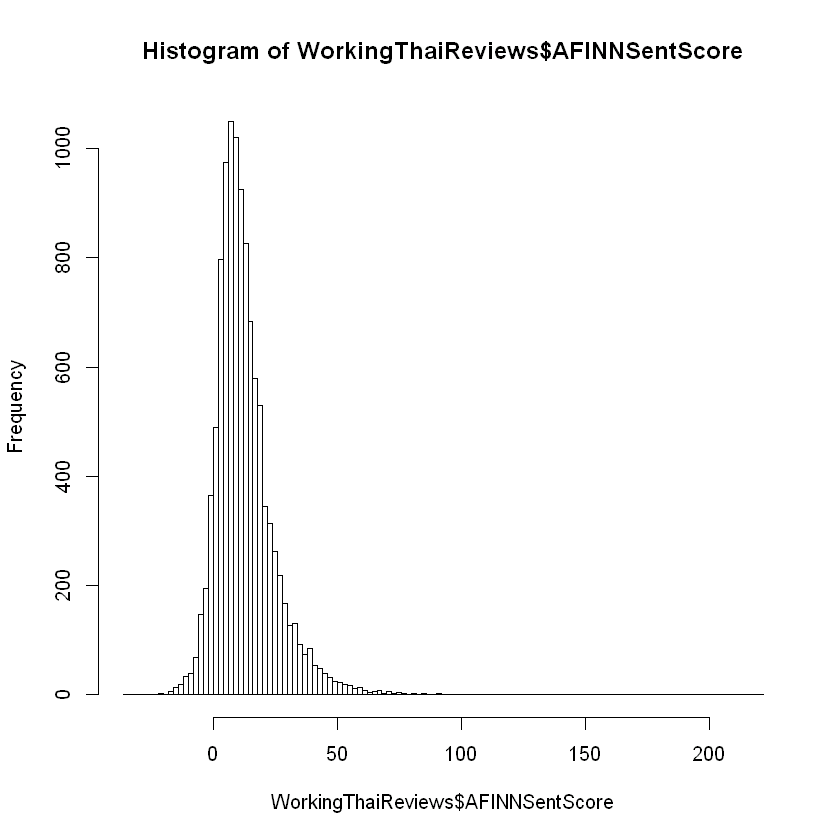

In [23]:
hist(WorkingThaiReviews$AFINNSentScore, breaks=113)
table(as.integer(WorkingThaiReviews$AFINNSentScore))
length(table(as.integer(WorkingThaiReviews$AFINNSentScore)))

##### Sentiment Scores Extracted with the AFFIN Lexicon Scaled to 1-5 with 0.5 Increments


   1  1.5    2  2.5    3  3.5    5 
   1  328 9573  952   54    2    1 

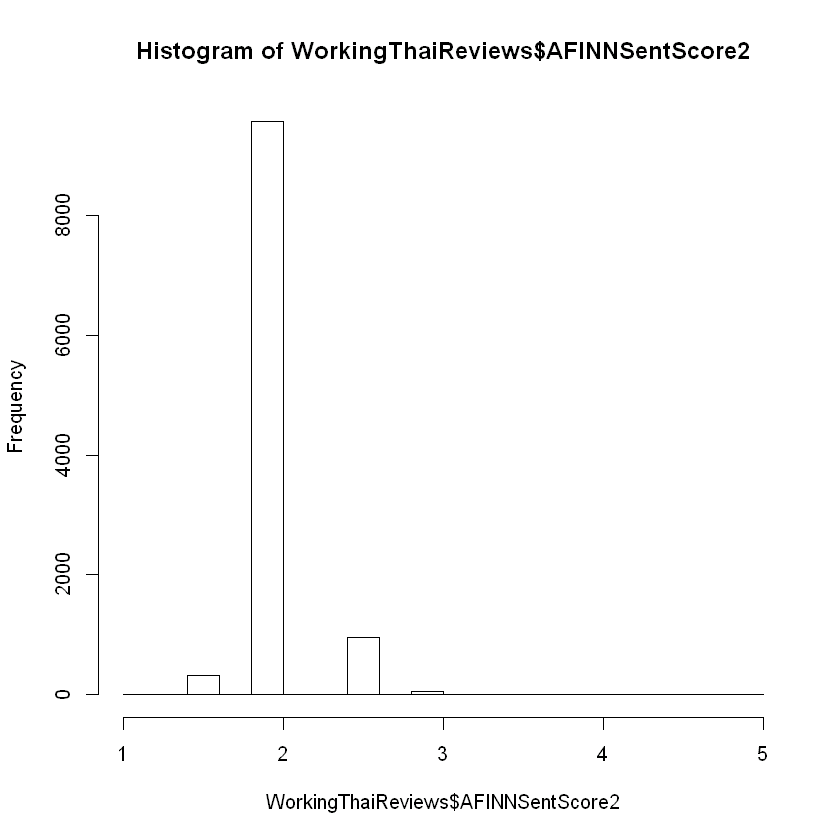

In [24]:
hist(WorkingThaiReviews$AFINNSentScore2)
table(WorkingThaiReviews$AFINNSentScore2)

##### Observations:

(1) The distribution of the unscaled scores (AFINNSentScore) is close to a normal bell curve although a great majority of the reviews express a positive sentiment (score = 0). The median is clearly left of zero.

(2) The distribution of scores scaled 1 to 5 with 0.5 increments show that the mode is in the 2 range, which means that a majority of reviews express a slightly positive sentiment. We are reminded that the majority of ratings given by users were in the range of 4 and 5.

### Execute Recommender Tasks with Sentiment Scores Extracted from the AFINN Lexicon (SCALED)

In this section of the console, we select the last five users of the matrix and attempt to produce with recommenderlab a list of top 5 Thai restaurants among all the restaurants regardless of their location. The idea is to keep as many users and restaurants as possible for the purpose of maintaining the similarity patterns between users, including negative sentiments. This exercise allows us to understand the inner workings of the model. We reproduce the results with a simple function and extend the work beyond the algorithm to produce top 5 restaurants in Las Vegas along the same logic. In other words, we develop a model that identifies the top 5 restaurants in Las Vegas (for suitable users). The next section adopts a more acceptable sampling strategy although data conversion problems prevent the accurate retrieval of saved samples for more meaningful cross-analysis. This sampling, although not random, gives us a sense of what is going on.

##### Create Matrices for Recommender Predictions

The commands in the cell below (1) build a non-binary matrix, (2) normalize the matrix through the center method, and (3) normalize the matrix with the Z-score method. The histograms derived from these show various distributions of ratings and one distribution of average sentiment scores per Thai Restaurant (per column).

[1] "First rows of the matrix (m7) with the first two columns only."


,-hWBlyI2k95yjU-cgwCKJg,-SNpLwJNup8N96yq7sBJyw
--65q1FpAL_UQtVZ2PTGew,NA,NA
--ijvARuRJhZrBdS9_jF2A,NA,NA
--ohLoec6PU9_yxhbIlVWg,NA,NA
--qEXbk-cA0HmbPyhcffdA,NA,NA
-_2B4LLGfWvxReflguaYrw,NA,NA
-_GtJEB9B4Ckm7Cd8RIq1A,NA,NA


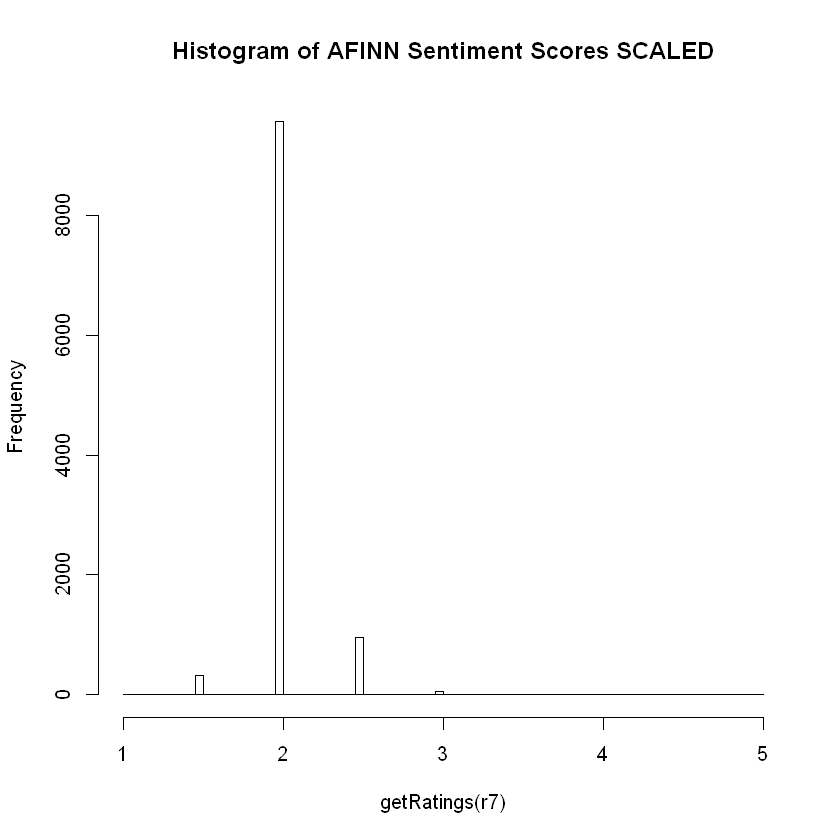

[1] "r7 is a"

7741 x 319 rating matrix of class 'realRatingMatrix' with 10911 ratings.

[1] "r7_n is a"

7741 x 319 rating matrix of class 'realRatingMatrix' with 10911 ratings.
Normalized using center on rows.

[1] "r7_nZ is a"

7741 x 319 rating matrix of class 'realRatingMatrix' with 10911 ratings.
Normalized using Z-score on rows.

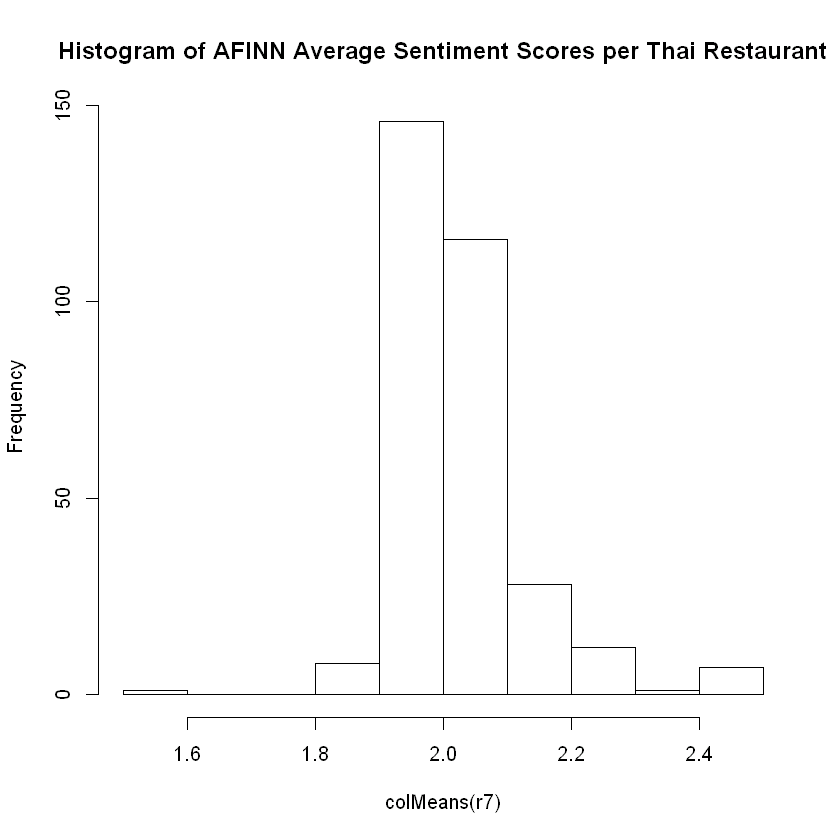

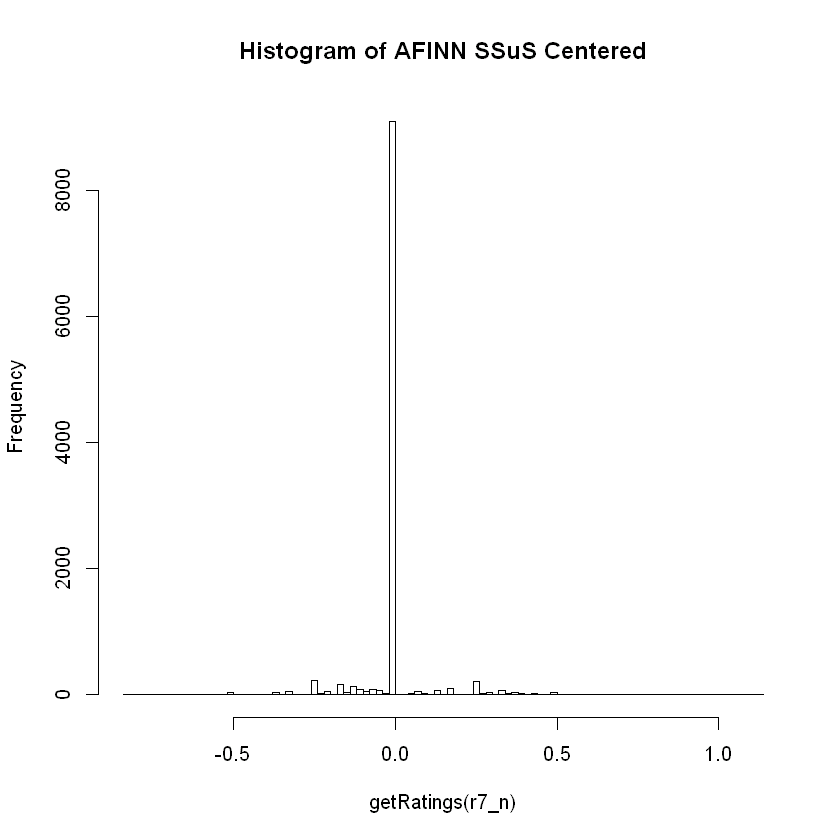

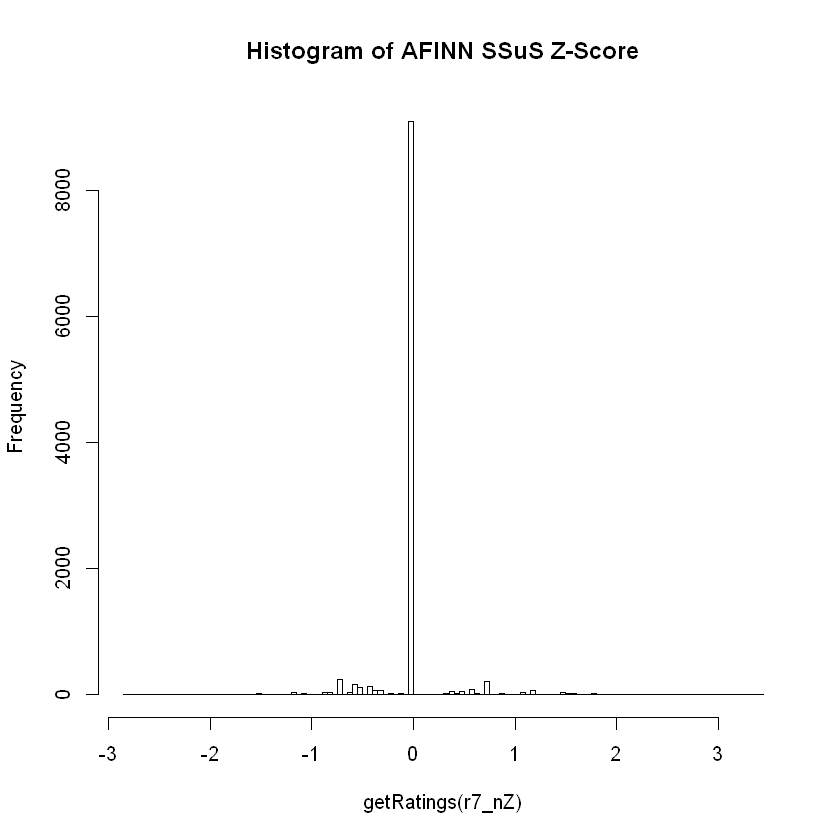

In [25]:
WThaiRAFINNSentScore2_flat <- WorkingThaiReviews[,c("user_id", "business_id", "AFINNSentScore2")]
WThaiRAFINNSentScore2_unique <- WThaiRAFINNSentScore2_flat[!duplicated(WThaiRAFINNSentScore2_flat[1:2]),]
thaiAFINNSentScore2 <- daply(WThaiRAFINNSentScore2_unique, .(user_id, business_id), function(x) x$AFINNSentScore2)
m7 <- data.matrix(thaiAFINNSentScore2)
print(paste0("First rows of the matrix (m7) with the first two columns only."))
head(m7[,1:2])
r7 <- as(m7, "realRatingMatrix")
r7LAS <- r7[,LASthaiRestaurants]

hist(getRatings(r7), breaks=113, main="Histogram of AFINN Sentiment Scores SCALED")
hist(colMeans(r7), main="Histogram of AFINN Average Sentiment Scores per Thai Restaurant")

    
r7_n <- normalize(r7)
r7_nZ <- normalize(r7, method="Z-score")


paste("r7 is a")
    r7
paste("r7_n is a")
    r7_n
paste("r7_nZ is a")
    r7_nZ

hist(getRatings(r7_n), breaks=113, main="Histogram of AFINN SSuS Centered")
hist(getRatings(r7_nZ), breaks=113, main="Histogram of AFINN SSuS Z-Score")


##### Observations:

(1) We observe that the normalized ratings from only the histogram using the Z-score method range from roughly -3 to 3. The histogram using the center method range from -0.5 to 1. These observations are key to our understanding of the recommenderlab algorithm. They suggest, when we use later the "center" and "Z-score" methods in the "Recommender" function (later in the console) that the data is denormalized subsequently, likely before the "predict" function has completed its work. This becomes clearer with the accuracy results for the Unscaled Sentiment Scores as their range are much greater than the classical Z-score ranges. See cell 96 in console titled 'recommender_with_AFINN_scores_unscaled.ipynb'. Below is another representation of the distribution of the scaled data, normalized through the center method, and normalized through the Z-score method.

##### Show Raw and Normalized Data

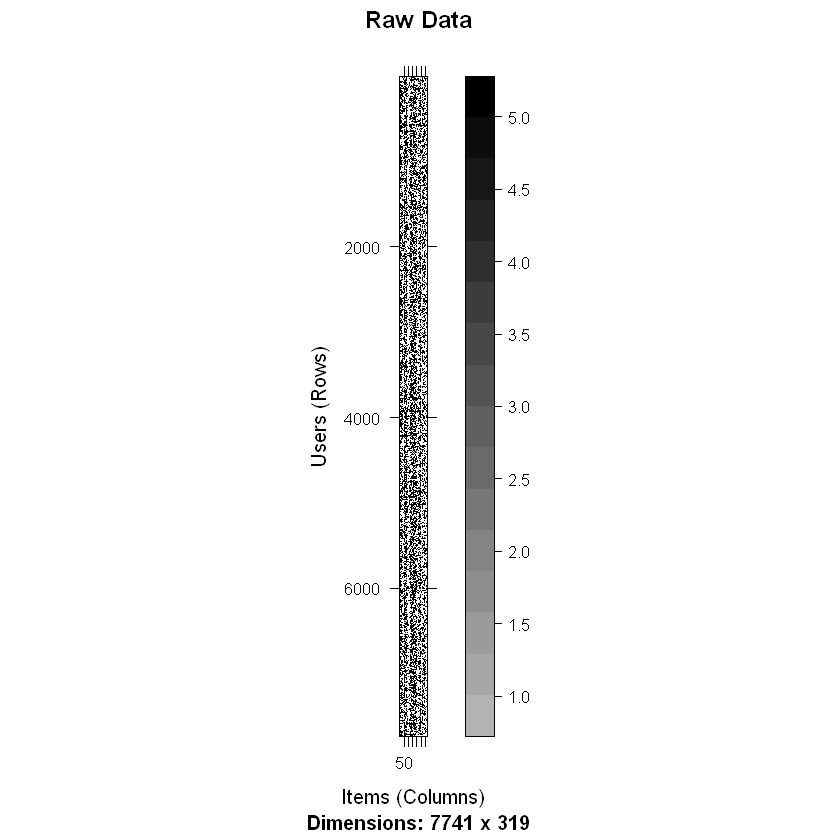

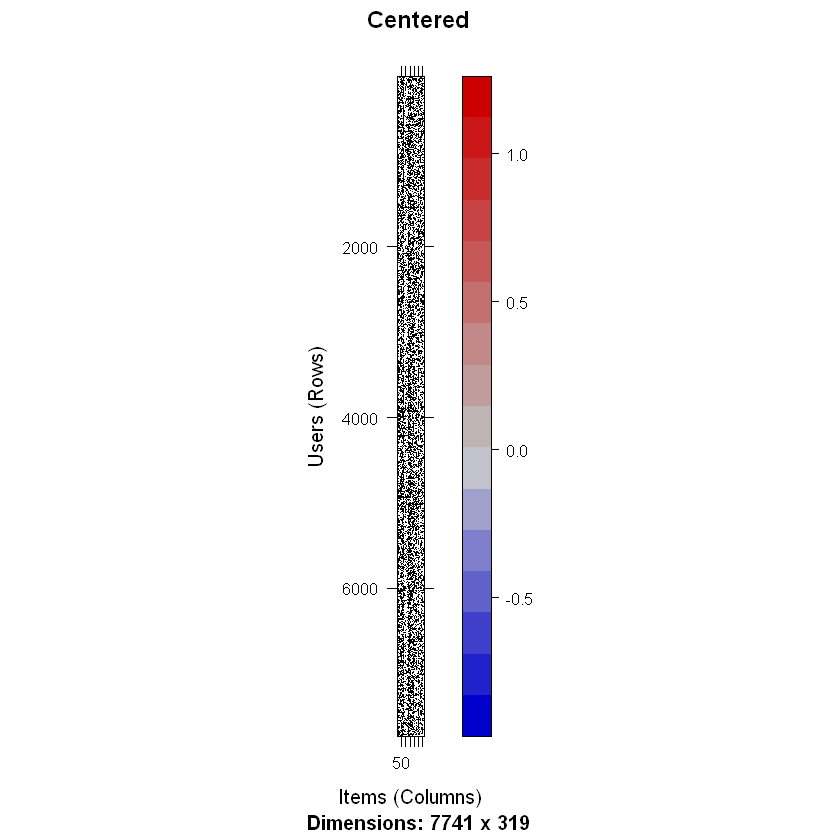

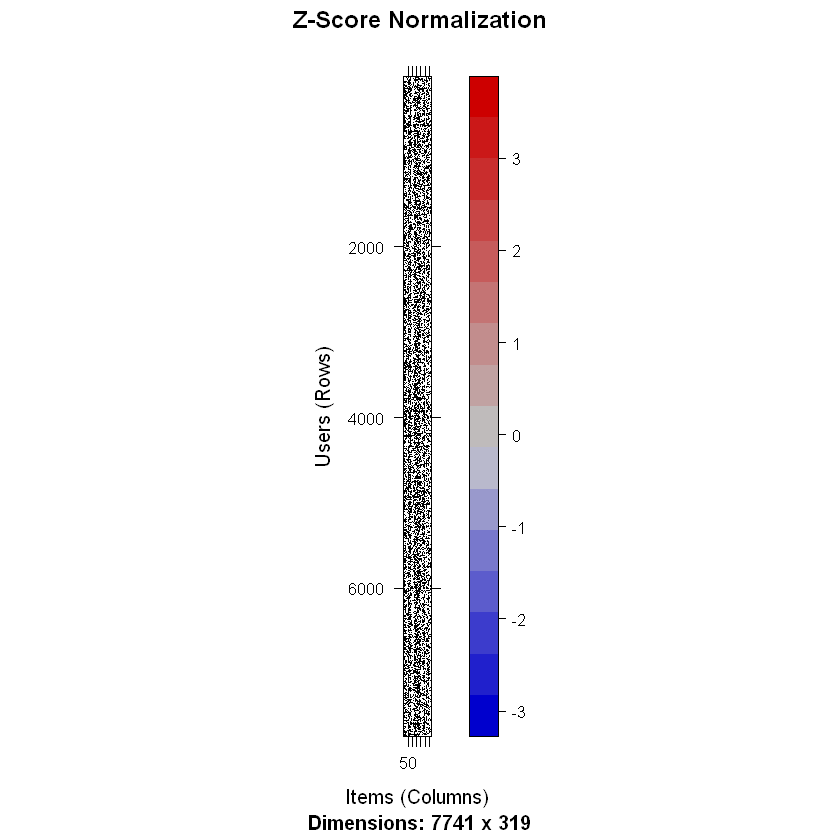

In [26]:
image(r7, main="Raw Data")
image(r7_n, main="Centered")
image(r7_nZ, main="Z-Score Normalization")

#### Produce a List of Top 5 Thai Restaurants for the Scaled AFINN Dataset and a Matrix for Thai Restaurants in Las Vegas 

This subsection takes us through a number of steps. In addition to producing a list of top 5 restaurants for the last five users of the matrix, it provides insight into the recommendations produced by recommenderlab. The results from the section below this subsection suggest that, when we do not specify the normalization approach and the similarity-determination method (the case in this subsection), the "Recommender" function assumes a "center" approach and a "cosine similarity" method. We acknowledge that this approach and this method may not provide the best accuracy and the best list of recommendations beyond the top 5. The purpose of this subsection is to understand how the recommendations were produced and why the recommendations provided are no recommendations at all. To achieve this, we study the recommendations for User 1, 4, and 2, which is the user sample we used in the other consoles. "recommenderlab" produced no recommendations at all for User 2 although it produced the first five restaurants of the matrix as recommendations for User 1, 3, 4 and 5. We omit a study of the recommendations for Users 3 and 5 as we did in the other consoles. Last but not least, this subsection shows how we developed a simple model for identifying the top 5 restaurants "IN LAS VEGAS" from the recommenderlab predictions.

In [27]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7 <- Recommender(r7_train, method = "UBCF")
recom7 <- predict(recommender7, r7_test, n=5)
recom7
as(recom7, "list")
recom37 <- bestN(recom7, n = 3)
recom7_rate <- predict(recommender7, r7_test, type="ratings")
recom7_rate
as(recom7_rate, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
character(0)

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

5 x 319 rating matrix of class 'realRatingMatrix' with 1271 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2


##### Observations:

(1) The restaurants recommended to Users 1, 3, 4 and 5 are the same. In this scaled sample, User 4 was NOT recommended five distinct restaurants. NONE of the recommendations are meaningful.

(2) "recommenderlab" produced no recommendations for User 2.

##### Repeat the recommendation list for easier reference

In [28]:
as(recom7, "list")

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
character(0)

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

##### Recreate Results  from recommenderlab's topNList for Insight into the Data with Similar Function

In [29]:
predScoresFORr7_test <- as(recom7_rate, "matrix")

In [30]:
t(apply(predScoresFORr7_test, 1, FUN= function(x) order(-x)[1:5]))

1,2,3,4,5
1,2,3,4,5
1,2,3,4,5
1,2,3,4,5
1,2,3,4,5


##### Observations:

(1) Each row brings forward the column numbers where the predicted score value is highest in descending order. Each column number is associated with a restaurant ID. 

(2) For all 5 rows, the predicted scores are the same across the matrix. The function returns the first five restaurants in the matrix; therefore, the recommendations are NOT useful as they are biased towards those restaurants that are listed first. 

##### Create a List of Column Numbers for Each Sample User for Further Filtering Purposes

In [31]:
colnumlist <- as.list(as.data.frame(apply(predScoresFORr7_test, 1, FUN= function(x) order(-x)[1:5])))
colnumlist

$V1
[1] 1 2 3 4 5

$V2
[1] 1 2 3 4 5

$V3
[1] 1 2 3 4 5

$V4
[1] 1 2 3 4 5

$V5
[1] 1 2 3 4 5

##### Identify the User Names from the Test Sample

In [32]:
usersample7 <- rownames(m7[(nrow(m7)-4):nrow(m7),0])
usersample7

[1] "ZZkw1Z5fGyFbtiKwl63utQ" "ZzLJjIhGu6z8jZVAnUfstg" "ZZLpFOMzeGjtOJ5nE5Ixdg"
[4] "zZxr7X10CDThXZbnkLmNVA" "ZzXsskFHBYlHigIC0mX9lg"

### User 1

 ##### Identify User 1 by User ID

In [33]:
user1sample7 <- usersample7[1]
user1sample7

[1] "ZZkw1Z5fGyFbtiKwl63utQ"

##### Identify the Top 5 Thai Restaurants Recommended from the recommenderlab Predict Matrix for User 1

In [34]:
restaurants4user1 <- colnames(predScoresFORr7_test[,colnumlist$V1])
restaurants4user1

[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

##### Identify Sentiment Scores from Top 5 Restaurant Reviews for User 1 

In [35]:
scores4user1sample7 <- m7[usersample7[1],restaurants4user1]
t(as(scores4user1sample7, "matrix"))

-hWBlyI2k95yjU-cgwCKJg,-SNpLwJNup8N96yq7sBJyw,_0LwsuDU1lG2lwFBrCgzCA,_BL-KfyZqYruqDvxTY-vUg,_IE5XDjxeM47NSzhg7sItg
NA,NA,NA,NA,NA


##### Observations:

(1) We confirm that the restaurants selected were not reviewed by User 1.

##### Identify Score Predictions for Top 5 Thai Restaurants Recommended by recommenderlab for User 1

In [36]:
predictedscores4user1sample7 <-recom7_rate[1,restaurants4user1]
as(predictedscores4user1sample7, "matrix")

-hWBlyI2k95yjU-cgwCKJg,-SNpLwJNup8N96yq7sBJyw,_0LwsuDU1lG2lwFBrCgzCA,_BL-KfyZqYruqDvxTY-vUg,_IE5XDjxeM47NSzhg7sItg
2,2,2,2,2


#### Observations:

(1) As we have seen above, these predictions can be misleading as they are NOT the top 5 Thai restaurants: they are simply the first five restaurants in the matrix. The predicted scores are equal to the score computed for the user's unique review. This is one of the ways recommenderlab deals with the cold-start problem. It appears that the "given" parameter normally found in the "evaluationScheme" function (this creates training and testing sets according to various random sampling methods) requires a pre-filtering of the data that excludes user instances with a number of scores that is lower than the parameter selected. While we don't experiment with the "given" parameter in this subsection, we do in the section below this subsection: recommenderlab generated in several of our tentatives a message saying it identified instances with only one rating and could not perform the task for a "given" parameter greater than 1. Again, in this subsection, we do not use random sampling.

##### Identify Thai Restaurants Listed in the First Five Rows of the Prediction Matrix (recom7_rate) for User 1

In [37]:
restaurantids <- colnames(as(predictedscores4user1sample7, "matrix"))
restaurantids
restaurantids_df <- as.data.frame(restaurantids)
colnames(restaurantids_df) <- "business_id"
merge(x= restaurantids_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,-hWBlyI2k95yjU-cgwCKJg,Reign Of Thai,"12032 Cave Creek Rd Phoenix, AZ 85020",[],Phoenix,AZ,33.59605,-112.0386,2,4.5,True
2,-SNpLwJNup8N96yq7sBJyw,Thai Style Noodle House,"3516 Wynn Rd Chinatown Las Vegas, NV 89103",[Chinatown],Las Vegas,NV,36.12589,-115.1944,1,4,True
3,_0LwsuDU1lG2lwFBrCgzCA,Red Bowl Asian Bistro,"2538A Mt Holly-Huntersville Rd Charlotte, NC 28216",[],Charlotte,NC,35.33738,-80.93515,2,3.5,True
4,_BL-KfyZqYruqDvxTY-vUg,Surang's Thai Kitchen,"5455 S Fort Apache Rd Ste 105 Spring Valley Las Vegas, NV 89148",[Spring Valley],Las Vegas,NV,36.08956,-115.2974,2,4,True
5,_IE5XDjxeM47NSzhg7sItg,Pink Pepper Thai Cuisine,"245 E Bell Rd Phoenix, AZ 85022",[],Phoenix,AZ,33.63947,-112.0715,2,3.5,True


##### Observations:

(1) We observe no specific order from the data: no order by avg_stars, no alphabetic order by name.

(2) We observe that the list contains restaurants in Phoenix, Charlotte and LAS VEGAS, but these recommendations are not useful: they are simply the first five in the matrix.

##### Identify Thai Restaurants Reviewed by User 1 and the Computed Sentiment Scores

In [38]:
t(as(na.omit(m7[user1sample7,]), "matrix"))
thairest1_ids <- colnames(t(as(na.omit(m7[user1sample7,]), "matrix")))

joxWCp6dgN-kTE9GMziwjA
2


##### Observations: 

(1) We observe that User 1 reviewed only one restaurant all together.  The sentiment score from the review is used as the predicted scores. 

##### Identify the Names and Key Attributes of the Thai Restaurant(s) Reviewed by User 1

In [39]:
subset(ThaiRestaurants, business_id==thairest1_ids)

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
9318,joxWCp6dgN-kTE9GMziwjA,Mango Thai,"1440 S Country Club Dr Ste 10 Mesa, AZ 85210",[],Mesa,AZ,33.38807,-111.8414,1,3,True


##### Identify Users who Reviewed the Same Thai Restaurant as User 1 and the Associated Scores

In [40]:
na.omit(m7[,thairest1_ids])
paste("The length is:", length(na.omit(m7[,thairest1_ids])))
paste("The median is:", median(na.omit(m7[,thairest1_ids])))
paste("The mean is:", mean(na.omit(m7[,thairest1_ids])))

5J5OrLqqOxilT_qqibuqsw 6fnYVUMR9xr9t8i0pL35jg 8qe2c5uRlAkvNFvDriBm1Q 
                   2.0                    2.0                    2.0 
A6QRTCKvyplV-NBC9L_SDg buOO6GWXeTN0y1nMR9ailA cCuCmASl2J8OstEWTb6tTQ 
                   1.5                    2.0                    2.0 
cRyNICH0mhjxagvSyVr60Q dbgrCZFswU_5WrKmSTf_fg EKUTzT9CK02SFYmxT_DaCA 
                   2.0                    2.0                    2.5 
I6ukj5qeZYl68fntWD0DTA IW59bVLSkyOvFgycFNEUTA jb0AksiLfGQAJw4iLWIiBw 
                   2.5                    2.0                    2.0 
k5U-0FBwvWUob8dlT6RvmA MzaALPvptGShwpy1w0dEsQ Qyh65muysp06AdaXgUOf9w 
                   2.0                    2.0                    2.0 
rIkxXjBKAeKKSYfLMgocLA SEjYxEV_Y723uyTq3ADBvw t8Hq6kURxGQhqRmAqbG02g 
                   2.0                    2.0                    2.0 
tkVq2kTwibRC3mekEDpurg TQ5eVGOFr_qB5_BbEd3Sow v-QDmwxSsdt7mzm-3LAefQ 
                   2.0                    2.5                    2.0 
X8-fj4HEWzLg3KwofSUugA yoJ_6oSFk5p-uHphaquHMw YsSeLrUpzGl-uYSBz_TwWQ 
                   2.0                    1.5                    2.0 
zmZtT1T6-J4NcqP8j1L5jA ZZkw1Z5fGyFbtiKwl63utQ 
                   2.0                    2.0 
attr(,"na.action")
--65q1FpAL_UQtVZ2PTGew --ijvARuRJhZrBdS9_jF2A --ohLoec6PU9_yxhbIlVWg 
                     1                      2                      3 
--qEXbk-cA0HmbPyhcffdA -_2B4LLGfWvxReflguaYrw -_GtJEB9B4Ckm7Cd8RIq1A 
                     4                      5                      6 
-0fMBkX7QvWKQrtOp7H-GQ -2EuoueswhqEERWezJY8gw -2Ig3GSBkj8JQT8eETmDPg 
                     7                      8                      9 
-3WzrbWjnaKg2QWAsouy_g -45GJdo8Ye8A1AStuUZp9Q -4c_mgQdLH5axJ3j2In5_Q 
                    10                     11                     12 
-7R1u0HzHKmhLy9qE2MBpw -8BqfYouq3o_UoazAQWwNw -8gRkiYaVm3zfoQ4pcg75w 
                    13                     14                     15 
-8pbvWZH7Czk9YW1UkW4Ng -9-fkZ72_Qg4E6YYYXMqSg -9g6w1xoj6-4iZH29P3h7g 
                    16                     17                     18 
-A01aSKVuOm42FnhvOCdKA -ARd7byPUILfnFVlKcn0Yg -ax9xtAlEckjcLz3iHk2_A 
                    19                     20                     21 
-beMkTJqbLt2l6L1xomJaA -BQFGG_hrORLkEs8oigCjg -BrtOvg4tL1xcaQnQTaZow 
                    22                     23                     24 
-BVv1TDLLphHzgKw-eAJJQ -ckkw0XxcRemL2-vnuHdUQ -ctrck_aTmPx8wW0AHc39g 
                    25                     26                     27 
-CyBQG3dc4UnpluY7UdMOA -d20QLhOPOAqkSno_0eRLg -DRza4wuHHWfQx5HcG6qaw 
                    28                     29                     30 
-dzrDpNe5f0hDud-S-W26w -e05nnRNiUF_72rHS52Swg -E7e4sTuVAHwwWjQYBG07w 
                    31                     32                     33 
-EFuxDYchSSVkb4Q9Iivpg -eIsz3-MIQT6ueiM4MusHg -eu6RCy7D5mqm69aeELM6w 
                    34                     35                     36 
-EyEj5BujVFisco6OwmR8A -F32Vl8Rk4dwsmk0f2wRIw -Fc2l6BV2zTKnyRqT5b5mw 
                    37                     38                     39 
-fD-fj6eGikdiHKCS064bQ -Fi7zyYkdWrrChGRF4mIBQ -flk3mw_ToHZFszsgFimGA 
                    40                     41                     42 
-fLNSrmT9BGrrkXdvC0aPQ -FpJ2cYA2Z8M1eE1J0jPQQ -Gdjho_gZhgTXkYmSPy0qw 
                    43                     44                     45 
-GNcVLtPu1QlJ07cMRe4zw -GPQbucelen3W0yCtSdcFQ -GYSHHxHYd6uTrqlTw_OGg 
                    46                     47                     48 
-H1Tpjht7XhMB-o3Y9qFQg -H7hd6l1GIEyyAWe0uCybA -Hv0mbeVlO2nB-6cYcfFMg 
                    49                     50                     51 
-iArS6zaHaXYjT20N1vXhg -iySM75qq_cNa_wvPY--Ig -jArZigWp_awu-Q3EYRDUg 
                    52                     53                     54 
-JLDeGHE2Oh0hHQuyVuVLw -JLiC5WLQIu2usjYTNmS2w -JLWPLhXK3WR4-33bJRauA 
                    55                     56                     57 
-jNc1Ko1rHhlibmmy3U7Pw -jXv_FyllqkPrbZZpSRn2Q -KbNcM_9wkA4MhuyCONTfg 
                    58               

[1] "The length is: 26"

[1] "The median is: 2"

[1] "The mean is: 2.01923076923077"

In [41]:
summary(m7[,thairest1_ids])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
  1.500   2.000   2.000   2.019   2.000   2.500    7715 

##### Observations:

(1) Among the 26 users that rated the restaurant, the median is 2.0 and the mean is almost 2.019. This means that a majority of users expressed a positive sentiment in the review(s). Recommenderlab did not omit to produce recommendations for User 1 although the recommendations it provided have NO real meaning.

### USER 4

##### Identify User 4  by User ID

In [42]:
user4sample7 <- usersample7[4]
user4sample7

[1] "zZxr7X10CDThXZbnkLmNVA"

##### Identify the Top 5 Thai Restaurants Recommended from the Predict Matrix for User 4

In [43]:
restaurants4user4 <- colnames(predScoresFORr7_test[,colnumlist$V4])
restaurants4user4

[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

##### Identify Sentiment Scores from Top 5 Restaurant Reviews for User 4

In [44]:
scores4user4sample7 <- m7[usersample7[4],restaurants4user4]
t(as(scores4user4sample7, "matrix"))

-hWBlyI2k95yjU-cgwCKJg,-SNpLwJNup8N96yq7sBJyw,_0LwsuDU1lG2lwFBrCgzCA,_BL-KfyZqYruqDvxTY-vUg,_IE5XDjxeM47NSzhg7sItg
NA,NA,NA,NA,NA


##### Observations:

(1) We confirm that the user did not review the restaurants recommended by the model.

##### Identify Score Predictions for Top 5 Thai Restaurants Recommended by recommenderlab for User 4 

In [45]:
predictedscores4user4sample7 <-recom7_rate[4,restaurants4user4]
as(predictedscores4user4sample7, "matrix")

-hWBlyI2k95yjU-cgwCKJg,-SNpLwJNup8N96yq7sBJyw,_0LwsuDU1lG2lwFBrCgzCA,_BL-KfyZqYruqDvxTY-vUg,_IE5XDjxeM47NSzhg7sItg
2,2,2,2,2


##### Observations:

(1) The predicted scores are equal to 2 across the 5 restaurants identified.

##### Identify the Names and Key Attributes of the Top 5 Thai Restaurants Recommended by the Model for User 4

In [46]:
restaurantids4 <- colnames(as(predictedscores4user4sample7, "matrix"))
restaurantids4
restaurantids4_df <- as.data.frame(restaurantids4)
colnames(restaurantids4_df) <- "business_id"
merge(x= restaurantids4_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,-hWBlyI2k95yjU-cgwCKJg,Reign Of Thai,"12032 Cave Creek Rd Phoenix, AZ 85020",[],Phoenix,AZ,33.59605,-112.0386,2,4.5,True
2,-SNpLwJNup8N96yq7sBJyw,Thai Style Noodle House,"3516 Wynn Rd Chinatown Las Vegas, NV 89103",[Chinatown],Las Vegas,NV,36.12589,-115.1944,1,4,True
3,_0LwsuDU1lG2lwFBrCgzCA,Red Bowl Asian Bistro,"2538A Mt Holly-Huntersville Rd Charlotte, NC 28216",[],Charlotte,NC,35.33738,-80.93515,2,3.5,True
4,_BL-KfyZqYruqDvxTY-vUg,Surang's Thai Kitchen,"5455 S Fort Apache Rd Ste 105 Spring Valley Las Vegas, NV 89148",[Spring Valley],Las Vegas,NV,36.08956,-115.2974,2,4,True
5,_IE5XDjxeM47NSzhg7sItg,Pink Pepper Thai Cuisine,"245 E Bell Rd Phoenix, AZ 85022",[],Phoenix,AZ,33.63947,-112.0715,2,3.5,True


##### Observations:

(1) The list provides the 5 first restaurants of the matrix. They are NOT located exclusively in Arizona, like this was the case with User 4 in the unscaled AFINN console. 

(2) We note two restaurants that are located in Las Vegas, but their predicted scores are not differentiated from other restaurants. 

(3) The price_range is 1 or 2.

##### Identify Thai Restaurants Reviewed by User 4 and the Computed Sentiment Scores from the Reviews

In [47]:
t(as(na.omit(m7[user4sample7,]), "matrix"))
thairest4_ids <- colnames(t(as(na.omit(m7[user4sample7,]), "matrix")))

shCdCHRbnY5FTMJbWl-myQ,xcxkEmy4CD-qaJUqprvpHA
2,2


In [48]:
thairest4_ids_df <- as.data.frame(thairest4_ids)
colnames(thairest4_ids_df) <- "business_id"
thairest4_ids
merge(x = thairest4_ids_df, y = ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

[1] "shCdCHRbnY5FTMJbWl-myQ" "xcxkEmy4CD-qaJUqprvpHA"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,shCdCHRbnY5FTMJbWl-myQ,Thai Spices,"66 S Dobson Rd Ste 133 Mesa, AZ 85202",[],Mesa,AZ,33.41271,-111.8758,2,4,True
2,xcxkEmy4CD-qaJUqprvpHA,Cha Da Thai,"8989 E Via Linda Ste 101 Scottsdale, AZ 85258",[],Scottsdale,AZ,33.56866,-111.8889,2,4.5,True


(1) Unlike the ratings and the YRR sentiment scores, User 4 has two positive ratings that are equal to 2. There seems to be a discrepancy between the two lexicons.

(2) The price range is 2.

(3) The two restaurants reviewed by the user are in Greater Phoenix (AZ).

### User 2 (Control Variable)

##### Identify User 2 by User ID

In [49]:
user2sample7 <- usersample7[2]
user2sample7

[1] "ZzLJjIhGu6z8jZVAnUfstg"

##### Identify Thai Restaurants Reviewed by User 2 and the Computed Sentiment Scores

In [50]:
t(as(na.omit(m7[user2sample7,]), "matrix"))

qPrLJ6TibtKZAogClraJNA
2


In [51]:
thairestaurantreviewedbyUser2Sample7 <- colnames(t(as(na.omit(m7[user2sample7,]), "matrix")))
thairestaurantreviewedbyUser2Sample7                                                      

[1] "qPrLJ6TibtKZAogClraJNA"

In [52]:
subset(ThaiRestaurants, business_id==thairestaurantreviewedbyUser2Sample7)

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
10041,qPrLJ6TibtKZAogClraJNA,Pei Wei Asian Diner,"McCarran International Airport 1198 Sir Patrick Ave Southeast Las Vegas, NV 89119",[Southeast],Las Vegas,NV,36.08852,-115.139,2,2.5,False


##### Identify Users who Reviewed the Thai Restaurant Reviewed by User 2 of Sample 7 and Associated Scores

In [53]:
na.omit(m7[,thairestaurantreviewedbyUser2Sample7])
paste("The length is:", length(na.omit(m7[,thairestaurantreviewedbyUser2Sample7])))
paste("The median is:", median(na.omit(m7[,thairestaurantreviewedbyUser2Sample7])))
paste("The mean is:", mean(na.omit(m7[,thairestaurantreviewedbyUser2Sample7])))
paste("The min is:", min(na.omit(m7[,thairestaurantreviewedbyUser2Sample7])))
paste("The maximum is:", max(na.omit(m7[,thairestaurantreviewedbyUser2Sample7])))

4p-qAdc_ZLXfieNwaZGNGA 7V5cgqWKvK6ui_hoQlWfhw 7WL-Z0ZpUA-tnXh5hYiOvA 
                   1.5                    2.0                    2.0 
bCDGiz5GkcmCMD8dvA28nw D-oQSHI_Xqr4-IPElR1ecw DqQf_U39vTcxd4nwNSbZ1w 
                   2.0                    2.0                    2.0 
ePxzwqgNLQnYoObzLYhYvg iaXbM4fBynXtUGxs7p-GIg LL03SJrdw17c5_2mEDG_gg 
                   2.0                    2.0                    1.5 
mNb-Mn78KAG0-dG4kLVVaQ P2kVk4cIWyK4e4h14RhK-Q phc7lq8JtH_jVPac81K-eg 
                   2.0                    1.5                    2.0 
QAZWaZfxnX2x1mJAkFMBug qNBXPH_m3tSeSs_JbOyW3Q QShsqs3ulRjIQ0MSu3bqjw 
                   2.0                    2.0                    1.5 
RfXkO86tYbwsqwaPcTuxXQ SlExu-bSlQYltsodoB7ZOA XQEi55R-1ixSIydCect5xA 
                   2.0                    2.0                    2.0 
XTFE2ERq7YvaqGUgQYzVNA ZzLJjIhGu6z8jZVAnUfstg 
                   2.0                    2.0 
attr(,"na.action")
--65q1FpAL_UQtVZ2PTGew --ijvARuRJhZrBdS9_jF2A --ohLoec6PU9_yxhbIlVWg 
                     1                      2                      3 
--qEXbk-cA0HmbPyhcffdA -_2B4LLGfWvxReflguaYrw -_GtJEB9B4Ckm7Cd8RIq1A 
                     4                      5                      6 
-0fMBkX7QvWKQrtOp7H-GQ -2EuoueswhqEERWezJY8gw -2Ig3GSBkj8JQT8eETmDPg 
                     7                      8                      9 
-3WzrbWjnaKg2QWAsouy_g -45GJdo8Ye8A1AStuUZp9Q -4c_mgQdLH5axJ3j2In5_Q 
                    10                     11                     12 
-7R1u0HzHKmhLy9qE2MBpw -8BqfYouq3o_UoazAQWwNw -8gRkiYaVm3zfoQ4pcg75w 
                    13                     14                     15 
-8pbvWZH7Czk9YW1UkW4Ng -9-fkZ72_Qg4E6YYYXMqSg -9g6w1xoj6-4iZH29P3h7g 
                    16                     17                     18 
-A01aSKVuOm42FnhvOCdKA -ARd7byPUILfnFVlKcn0Yg -ax9xtAlEckjcLz3iHk2_A 
                    19                     20                     21 
-beMkTJqbLt2l6L1xomJaA -BQFGG_hrORLkEs8oigCjg -BrtOvg4tL1xcaQnQTaZow 
                    22                     23                     24 
-BVv1TDLLphHzgKw-eAJJQ -ckkw0XxcRemL2-vnuHdUQ -ctrck_aTmPx8wW0AHc39g 
                    25                     26                     27 
-CyBQG3dc4UnpluY7UdMOA -d20QLhOPOAqkSno_0eRLg -DRza4wuHHWfQx5HcG6qaw 
                    28                     29                     30 
-dzrDpNe5f0hDud-S-W26w -e05nnRNiUF_72rHS52Swg -E7e4sTuVAHwwWjQYBG07w 
                    31                     32                     33 
-EFuxDYchSSVkb4Q9Iivpg -eIsz3-MIQT6ueiM4MusHg -eu6RCy7D5mqm69aeELM6w 
                    34                     35                     36 
-EyEj5BujVFisco6OwmR8A -F32Vl8Rk4dwsmk0f2wRIw -Fc2l6BV2zTKnyRqT5b5mw 
                    37                     38                     39 
-fD-fj6eGikdiHKCS064bQ -Fi7zyYkdWrrChGRF4mIBQ -flk3mw_ToHZFszsgFimGA 
                    40                     41                     42 
-fLNSrmT9BGrrkXdvC0aPQ -FpJ2cYA2Z8M1eE1J0jPQQ -Gdjho_gZhgTXkYmSPy0qw 
                    43                     44                     45 
-GNcVLtPu1QlJ07cMRe4zw -GPQbucelen3W0yCtSdcFQ -GYSHHxHYd6uTrqlTw_OGg 
                    46                     47                     48 
-H1Tpjht7XhMB-o3Y9qFQg -H7hd6l1GIEyyAWe0uCybA -Hv0mbeVlO2nB-6cYcfFMg 
                    49                     50                     51 
-iArS6zaHaXYjT20N1vXhg -iySM75qq_cNa_wvPY--Ig -jArZigWp_awu-Q3EYRDUg 
                    52                     53                     54 
-JLDeGHE2Oh0hHQuyVuVLw -JLiC5WLQIu2usjYTNmS2w -JLWPLhXK3WR4-33bJRauA 
                    55                     56                     57 
-jNc1Ko1rHhlibmmy3U7Pw -jXv_FyllqkPrbZZpSRn2Q -KbNcM_9wkA4MhuyCONTfg 
                    58                     59                     60 
-KCR0e2Nyc7a7qvqnr9njQ -kCWyWuA2AfF63RRqfxTlA -kIvLyWpY17aRa0vPp-RmA 
                    61                     62                     63 
-L0i4tIcOIbAq_gPvykkLA -l3JUkVxUj2e7Q9u42bzJA -la6YVHqiwf2fR8o617mBQ 
                    64               

[1] "The length is: 20"

[1] "The median is: 2"

[1] "The mean is: 1.9"

[1] "The min is: 1.5"

[1] "The maximum is: 2"

In [54]:
summary(m7[,thairestaurantreviewedbyUser2Sample7])

   Min. 1st Qu.  Median    Mean 3rd Qu.    Max.    NA's 
    1.5     2.0     2.0     1.9     2.0     2.0    7721 

##### Observations:

(1) We note that there are no recommendations for User 2 in the sample extracted with topNList whereas the analyst's function provides a list similar to Users 1, 3, 4 and 5.

(2) We observe that the single review from User 2 is part of a series of 20 reviews that are for the most part skewed to positive (median = 2.0, mean = 1.9). This is NOT consistent with the rating results in the console titled "recommender with ratings", nor with the score results in the console titled "recommender with YelpRRL scores unscaled". It's not clear how recommender makes the decision NOT to list recommendations.

(3) The average star rating for the restaurant rated by User 2 was 2.5, below 3 which is the neutral rating. We don't know whether the restaurant was rated this low when the user made a decision to eat at this restaurant.

(4) The restaurant reviewed by User 2 is located at the international airport in Las Vegas, although this is not useful information in a situation where we have a restaurant review that generally expresses a negative sentiment and in a cold-start situation combined.

##### Conclusions:

(1) The findings for User 2 in this console help us reject the hypothesis that recommenderlab omits to make recommandations on the basis of generalized negative sentiments alone as proposed in another console.

(2) None of the recommendations provided here are useful.

### Create a list of Recommendations of Thai Restaurants in Las Vegas for User 4 with Scaled AFINN Sentiment Predictions (recom7_rate)

In this section, we apply the simple model we developed in the previous section to reproduce the recommenderlab results for our sample. We use the predictions from recom7_rate, for User 4 exclusively, which received recommendations that were meaningfull in other consoles. The purpose of this section is to create a list of top 5 restaurants in Las Vegas from this data for cross-reference purposes with other consoles. Again, the recommendations for User 4 were NOT meaningful in this exercise.

##### Recreate Results  from recommenderlab's topNList and Restrict Columns to Las Vegas Thai Restaurants

In [55]:
LASpredScoresFORr7_test <- as(recom7_rate, "matrix")[,LASthaiRestaurants]

##### Identify the Top 5 Thai Restaurants in Las Vegas Recommended from the recommenderlab Predict Matrix for the Test Sample

In [56]:
LAScolnumlist7 <- as.list(as.data.frame(apply(LASpredScoresFORr7_test, 1, FUN= function(x) order(-x)[1:5])))
LAScolnumlist7

$V1
[1] 1 2 3 4 5

$V2
[1] 1 2 3 4 5

$V3
[1] 1 2 3 4 5

$V4
[1] 1 2 3 4 5

$V5
[1] 1 2 3 4 5

##### Identify User 4 by User ID

In [57]:
user4sample7 <- usersample7[4]
user4sample7

[1] "zZxr7X10CDThXZbnkLmNVA"

##### Identify Top 5 Thai Restaurants in Las Vegas by Business ID for User 4

In [58]:
LASrestaurants4user4 <- colnames(LASpredScoresFORr7_test[,LAScolnumlist7$V4])
LASrestaurants4user4

[1] "V6csWcyvwOg_E2ni3V_CgA" "H2eCY4wIIudy5C0BW5Y3ZQ" "TLGCA3EQW_12ndci12dQWw"
[4] "dR-Zz3l3ws-P08dI6F8Zew" "DqzyOJTJXu0Iwi8og5DJDA"

##### Identify the Names and Key Attributes of the Top 5 Thai Restaurants in Las Vegas Recommended for User 4

In [59]:
LASrestaurants4user4_df <- as.data.frame(LASrestaurants4user4)
colnames(LASrestaurants4user4_df) <- "business_id"
merge(x= LASrestaurants4user4_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,V6csWcyvwOg_E2ni3V_CgA,Little Dumpling,"180 S Stephanie St Henderson, NV 89012",[],Henderson,NV,36.02288,-115.0466,1,3,False
2,H2eCY4wIIudy5C0BW5Y3ZQ,Bangkok Orchid,"4662 E Sunset Rd Henderson, NV 89014",[],Henderson,NV,36.07098,-115.0722,1,3.5,True
3,TLGCA3EQW_12ndci12dQWw,Bangkok 9 Thai-Chinese Food,"663 N Stephanie St Henderson, NV 89014",[],Henderson,NV,36.06579,-115.0463,2,3.5,True
4,dR-Zz3l3ws-P08dI6F8Zew,Royal Thai Restaurant,"3839 W Sahara Ave Ste 9 Westside Las Vegas, NV 89102",[Westside],Las Vegas,NV,36.14401,-115.1931,2,4.5,True
5,DqzyOJTJXu0Iwi8og5DJDA,Ocha Cuisine,"1201 Las Vegas Blvd S Downtown Las Vegas, NV 89104",[Downtown],Las Vegas,NV,36.15677,-115.1483,1,4,True


##### Identify Sentiment Scores from Top 5 Restaurant Reviews for User 4

In [60]:
LASscores4user4sample7 <- m7[usersample7[4],LASrestaurants4user4]
t(as(LASscores4user4sample7, "matrix"))

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA
NA,NA,NA,NA,NA


##### Observations:

(1) We confirm that the user did not review the 5 restaurants in the sample.

##### Identify Score Predictions for Top 5 Thai Restaurants in Las Vegas Recommended by recommenderlab for User 4 

In [61]:
predictedLASscores4user4sample7 <-recom7_rate[4,LASrestaurants4user4]
as(predictedLASscores4user4sample7, "matrix")

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA
2,2,2,2,2


##### Observations:

(1) We note that the scores predicted are equal to the score average of 2 from the two reviews given by User 4 across the columns.

(2) We note that User 4 did not have any meaningful score predictions. The recommendations are the same as the other four users. They are the first five restaurants of the matrix.

### VALIDATE AND EVALUATE THE ACCURACY OF THE MODEL for the AFINN Sentiment Scores (SCALED)

In this section, we use a cross-validation random sampling method (k=10) provided by recommenderlab to identify our training and test samples for the accuracy evaluation exercise. Unfortunately, due to conversion issues and a lack of time, we were unable to use the same samples for all the exercises, including those in other consoles. In addition, the sampler function requires certain parameters such as "goodRating" for the subsequent performance of the accuracy calculations of the model. If this parameter were part of a subsequent line of command, we could keep the same samples. The purpose of this section is to assess the accuracy of the various approaches and methods available and to recommend through the best method (with lower errors) the top 5 restaurants in LAS VEGAS for another much smaller random sample of reviewers of Las Vegas restaurants with at least one review. The latter decision is based on the assumption that at least one Thai restaurant in Phoenix was rated in addition to the one in Las Vegas, bringing a minimum of two ratings of restaurants for each of the sample users. Our objective is to increase our chances of getting some recommendations as we narrow down the sample to Las Vegas. We first execute the RMSE, MSE and MAE calculations for three goodRating values (min, neutral, median) and then go on in extracting a confusion matrix and related graphs for each of the three types of predictions (using min, neutral, median goodRating values). The other parameters remain constant.

##### (A) Execute the "evaluationScheme" Function with a Cross-validation Method and a "goodRating" Equal to the Minimum Score

We select in this first evaluationScheme a goodRating that will exclude no ratings regardless of the negative ratings associated with some reviews. In order to complete the accuracy prediction, recommenderlab requires that a goodRating be selected: we opted to start with the minimum value to override the requirement and to be able to identify differences from one approach to another. The accuracy prediction does not accept a goodRating that is equal to NULL. We also give the parameter "given" a value of 1 rating per user.

In [62]:
minscore_e7 <- min((WorkingThaiReviews$AFINNSentScore2))

In [127]:
minscore_e7

[1] 1

In [63]:
e7 <- evaluationScheme(r7[1:(nrow(r7)-5),], method="cross-validation", k=10, given=1, goodRating=minscore_e7)

In [64]:
e7

Evaluation scheme with 1 items given
Method: 'cross-validation' with 10 run(s).
Good ratings: >=1.000000
Data set: 7736 x 319 rating matrix of class 'realRatingMatrix' with 10905 ratings.

In [65]:
rec_e7 <- Recommender(getData(e7, "train"), "UBCF")
pred_rec_e7 <- predict(rec_e7, getData(e7, "known"), type="ratings")
err_rec_e7 <- calcPredictionAccuracy(pred_rec_e7, getData(e7, "unknown"))
err_rec_e7

RMSE      MSE      MAE 
2.345684 5.502233 1.499577

##### (B) Execute the "evaluationScheme" Function with a Cross-validation Method, a  "goodRating" equal to 0 and the "UBCF" Approach

We select in this evaluationScheme a goodRating that is equal to 0 (below the minimum).

In [66]:
e7crossGR0 <- evaluationScheme(r7[1:(nrow(r7)-5),], method="cross-validation", k=10, given=1, goodRating=0)

In [67]:
rec_e7crossGR0 <- Recommender(getData(e7crossGR0, "train"), "UBCF")
pred_rec_e7crossGR0 <- predict(rec_e7crossGR0, getData(e7crossGR0, "known"), type="ratings")
err_rec_e7crossGR0 <- calcPredictionAccuracy(pred_rec_e7crossGR0, getData(e7crossGR0, "unknown"))
err_rec_e7crossGR0

RMSE      MSE      MAE 
1.988134 3.952678 1.260136

##### Observations:

(1) We note that the accuracy of the predictions increases when we select  ratings that are greater than 0. Nevertheless, we acknowledge that the sample in (B) is probably different than (A); therefore, this observation has limited value.

#### (C) Execute the "evaluationScheme" Function with a Cross-validation Method, a "goodRating" equal to the Median and the "UBCF"

In [68]:
medianscore_e7 <- median((WorkingThaiReviews$AFINNSentScore2))
medianscore_e7

[1] 2

In [69]:
e7crossGRmed <- evaluationScheme(r7[1:(nrow(r7)-5),], method="cross-validation", k=10, given=1, goodRating=medianscore_e7)

In [70]:
rec_e7crossGRmed <- Recommender(getData(e7crossGRmed, "train"), "UBCF")
pred_rec_e7crossGRmed <- predict(rec_e7crossGRmed, getData(e7crossGRmed, "known"), type="ratings")
err_rec_e7crossGRmed <- calcPredictionAccuracy(pred_rec_e7crossGRmed, getData(e7crossGRmed, "unknown"))
err_rec_e7crossGRmed

RMSE      MSE      MAE 
2.040317 4.162892 1.447238

##### Observations:

(1) We note that the accuracy of the predictions increases when we select ratings that are in the neutral/positive range (2). 

#### (A) Evaluate the Accuracy of the top-N list of recommendations on e7 (goodRating = min (1))

When we choose to have a goodRating=NA in the evaluationScheme, we get an error message in this phase of the accuracy evaluation. Therefore, we selected in the previous section to give to e7 a goodRating equal to the AFINNSentScore minimum in order not to exclude any values. Without a goodRating, recommenderlab would not deliver a confusion matrix for the evaluation of the accuracy of the model.

##### Run the "evaluate" function on e7 for top N = 1, 3, 5, 10 with UBCF method (goodRating = minimum sentiment score)

In [71]:
evlist_e7 <- evaluate(e7, "UBCF", n=c(1,3,5,10))
avg(evlist_e7)

UBCF run 
	 1  [0sec/215.22sec] 
	 2  [0sec/221.33sec] 
	 3  [0sec/214.37sec] 
	 4  [0sec/210.9sec] 
	 5  [0.01sec/210.56sec] 
	 6  [0sec/199.59sec] 
	 7  [0sec/210.34sec] 
	 8  [0.01sec/219.56sec] 
	 9  [0sec/217.48sec] 
	 10  [0sec/210.47sec] 


,TP,FP,FN,TN,precision,recall,TPR,FPR
1,3.080873e-03,4.340180e-01,7.680359e-01,3.167949e+02,6.996694e-03,2.069481e-03,2.069481e-03,1.367023e-03
3,7.188703e-03,1.304108e+00,7.639281e-01,3.159248e+02,5.458564e-03,4.554949e-03,4.554949e-03,4.107567e-03
5,1.014121e-02,2.175353e+00,7.609756e-01,3.150535e+02,4.620399e-03,6.467951e-03,6.467951e-03,6.851838e-03
10,1.707317e-02,4.353915e+00,7.540436e-01,3.128750e+02,3.897536e-03,1.037051e-02,1.037051e-02,1.371393e-02


##### Observations:

(1) We observe that the FP are estimated to be quite high in the range of 1 for N=3, 2 for N=5 and 4 for N=10.

(2) We note that the TP are very low, although they are increasing with N. The TN are steadily decreasing from 317 for N=1 to 313 for N=10.

(3) Precision is highest at N=1 and decreasing by nearly half by N=10.

(4) Recall is increasing with N.

(5) The accuracy values are lower than in the ratings's accuracy table found in the console titled "recommender with ratings" for the same exercise; however, we acknowledge that the samples are likely different. Therefore, this observation has limited value.

##### Produce the Default ROC Curve (true positive rate (TPR) against false positive rate (FPR)) for evlist_e7

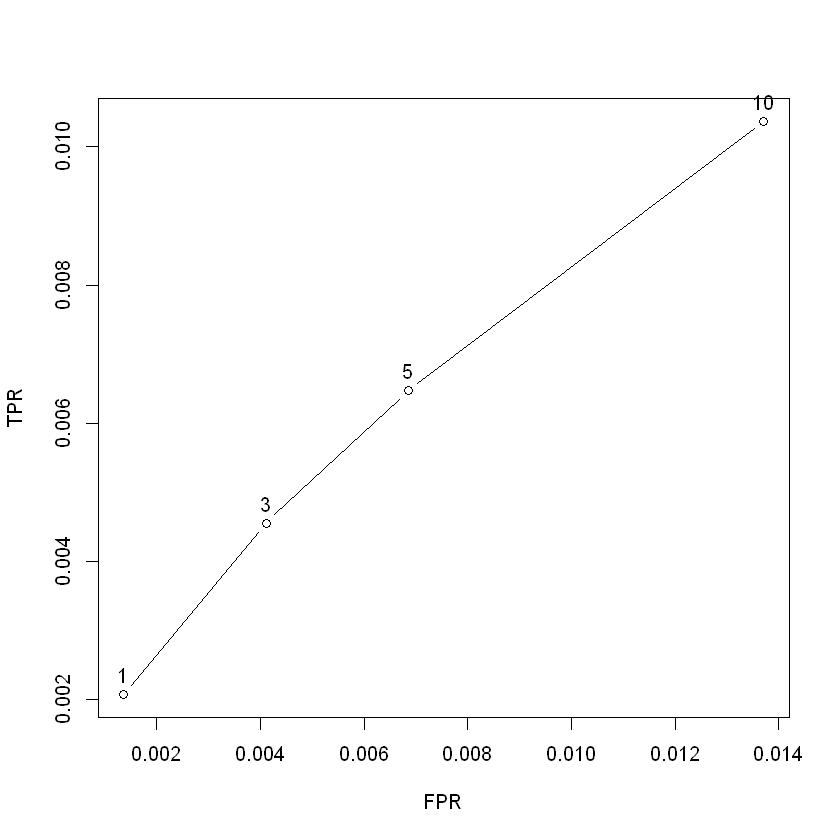

In [72]:
plot(evlist_e7, annotate=TRUE)

##### Produce a Precision-Recall Plot for evlist_e7crossGR0UBCF

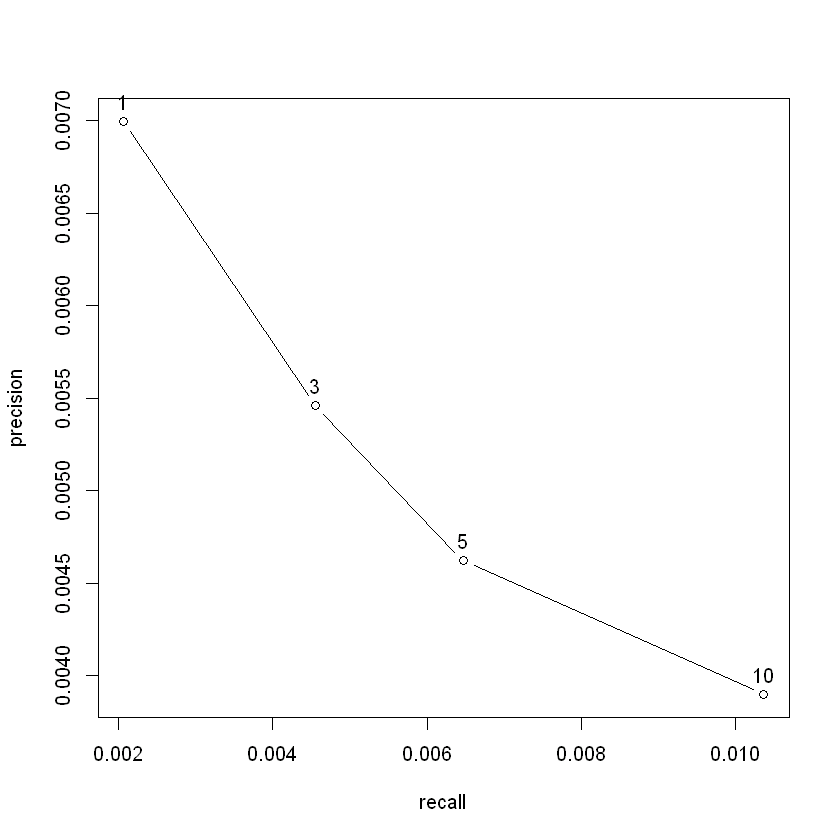

In [73]:
plot(evlist_e7, "prec/rec", annotate=TRUE)

##### Observations:

(1) Unlike the accuracy evaluation results for e7crooGR0UBCF below, the slopes are fairly steady.

(2) Precision is decreasing as N is increasing. 

#### (B) Evaluate the Accuracy of the top-N list of recommendations on e7crossGR0UBCF (goodRating = 0) 

We acknowledge that 0 is below the minimum (1) in the sample. The results are still interesting, although NOT conclusive.

##### Run the "evaluate" function on e7crossGR0UBCF for top N = 1, 3, 5, 10 with UBCF method (goodRating = neutral sentiment score (0))

In [74]:
evlist_e7crossGR0UBCF <- evaluate(e7crossGR0, "UBCF", n=c(1,3,5,10))
avg(evlist_e7crossGR0UBCF)

UBCF run 
	 1  [0sec/205.29sec] 
	 2  [0sec/223.32sec] 
	 3  [0sec/218.71sec] 
	 4  [0sec/205.02sec] 
	 5  [0sec/218.01sec] 
	 6  [0sec/227.09sec] 
	 7  [0sec/215.63sec] 
	 8  [0sec/223.1sec] 
	 9  [0sec/214.07sec] 
	 10  [0sec/209.7sec] 


,TP,FP,FN,TN,precision,recall,TPR,FPR
1,1.925546e-03,4.399230e-01,7.622593e-01,3.167959e+02,4.390055e-03,1.273646e-03,1.273646e-03,1.385645e-03
3,5.648267e-03,1.319897e+00,7.585366e-01,3.159159e+02,4.276524e-03,3.888583e-03,3.888583e-03,4.157341e-03
5,9.370988e-03,2.199872e+00,7.548139e-01,3.150359e+02,4.266469e-03,5.502492e-03,5.502492e-03,6.928980e-03
10,1.643132e-02,4.402054e+00,7.477535e-01,3.128338e+02,3.754504e-03,1.015625e-02,1.015625e-02,1.386539e-02


##### Observations: 

(1) The accuracy of the model with goodRatings = 0 generally decreases compared to the accuracy of the model with goodRatings = 1 (min). 

##### Produce the Default ROC Curve (true positive rate (TPR) against false positive rate (FPR)) for evlist_e7crossGR0UBCF

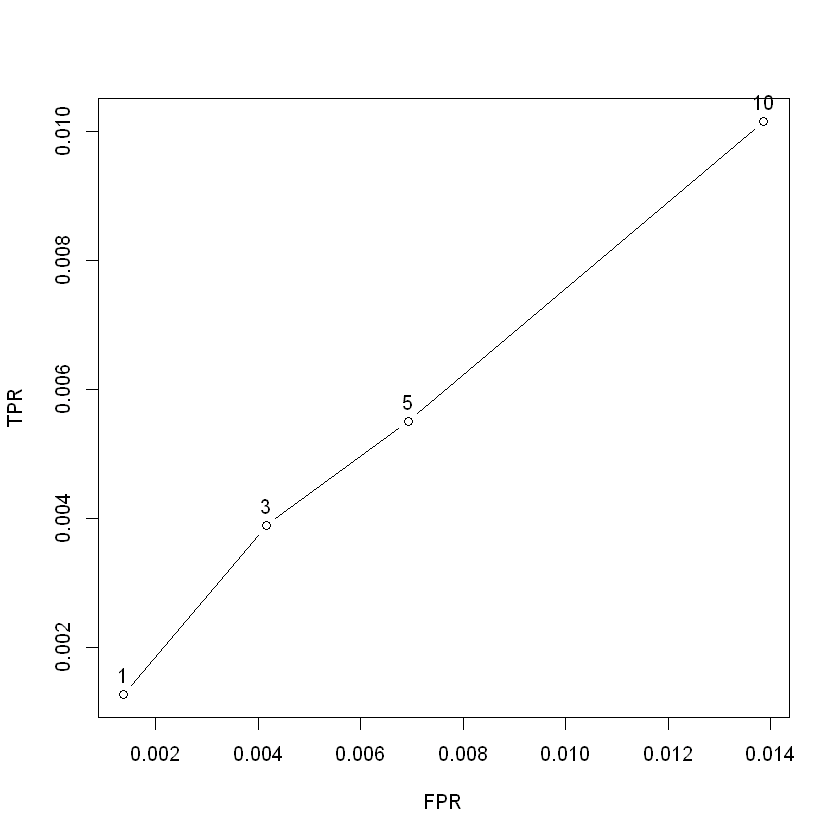

In [75]:
plot(evlist_e7crossGR0UBCF, annotate=TRUE)

##### Produce a Precision-Recall Plot for evlist_e7crossGR0UBCF

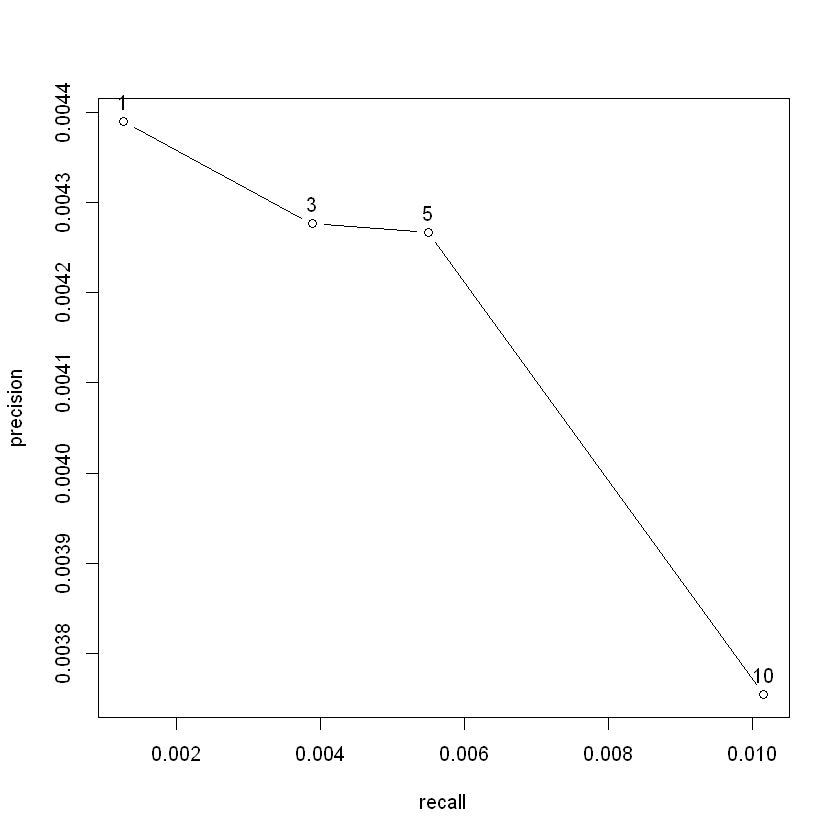

In [76]:
plot(evlist_e7crossGR0UBCF, "prec/rec", annotate=TRUE)

##### Observations:

(1) We note that the precision compared to recall is stable between N=3 and N=5. Again, this is a mystery. Why is the curve so different than the curve delivered with the minimum (1)?

#### (C) Evaluate the Accuracy of the top-N list of recommendations on e7crossGRmed (goodRating = median (2))

#### Run the "evaluate" function on e5crossGRmed for top N = 1, 3, 5, 10 with UBCF method (goodRating = median (2))

In [77]:
evlist_e7crossGRmed <- evaluate(e7crossGRmed, "UBCF", n=c(1,3,5,10))
avg(evlist_e7crossGRmed)

UBCF run 
	 1  [0.01sec/214.57sec] 
	 2  [0.01sec/206.49sec] 
	 3  [0sec/220.67sec] 
	 4  [0.01sec/208.28sec] 
	 5  [0.01sec/220.65sec] 
	 6  [0.02sec/220.77sec] 
	 7  [0sec/204.57sec] 
	 8  [0sec/212.52sec] 
	 9  [0.01sec/214.56sec] 
	 10  [0sec/218.86sec] 


,TP,FP,FN,TN,precision,recall,TPR,FPR
1,1.540436e-03,4.399230e-01,7.410783e-01,3.168175e+02,3.467535e-03,8.787185e-04,8.787185e-04,1.385595e-03
3,5.391528e-03,1.318999e+00,7.372272e-01,3.159384e+02,4.072163e-03,3.487314e-03,3.487314e-03,4.154361e-03
5,8.087291e-03,2.199230e+00,7.345315e-01,3.150582e+02,3.649755e-03,5.777813e-03,5.777813e-03,6.926804e-03
10,1.463415e-02,4.400000e+00,7.279846e-01,3.128574e+02,3.314398e-03,9.324678e-03,9.324678e-03,1.385843e-02


##### Observations:

(1) We observe that the FP are estimated to be quite high in the range of 1 for N=3, 2 for N=5 and 4 for N=10. These FP values are similar to the other two cases in this subsection.

(2) Clearly, the TP are very low, 0.02 for N=1, 0.005 for N=3, 0.008 for N=5 and 0.01 for N=10, although they are increasing with N. The TN are steadily decreasing from 317 for N=1 to 313 for N=10.

(3) The accuracy using the median is generally lower than the accuracy using the minimum.

#### Produce the Default ROC Curve (true positive rate (TPR) against false positive rate (FPR)) for evlist_e7crossGRmed (goodRating = 2)

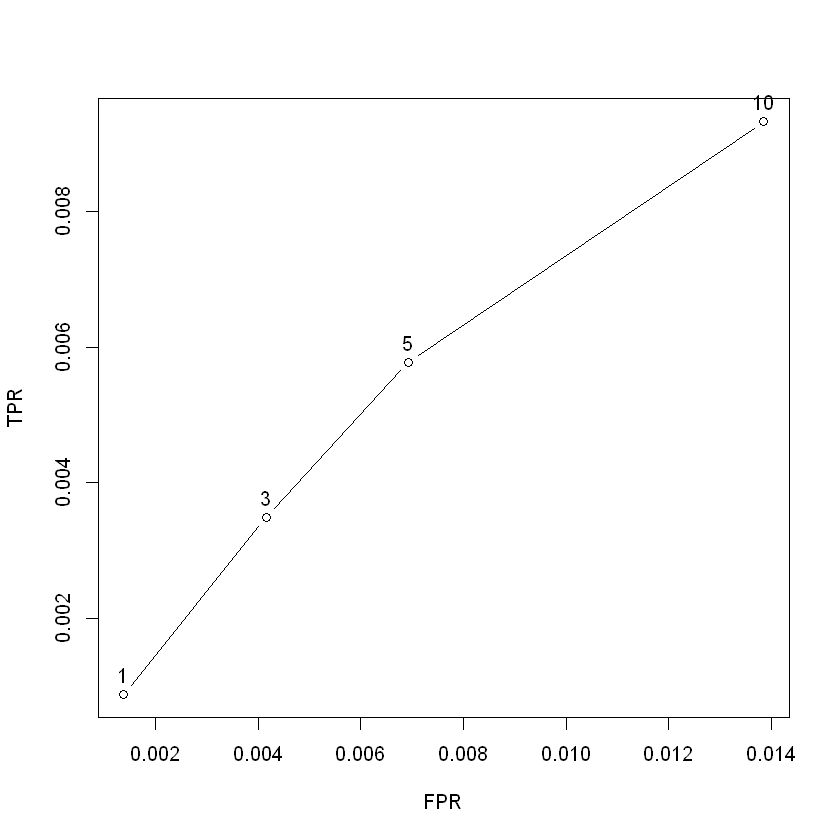

In [78]:
plot(evlist_e7crossGRmed, annotate=TRUE)

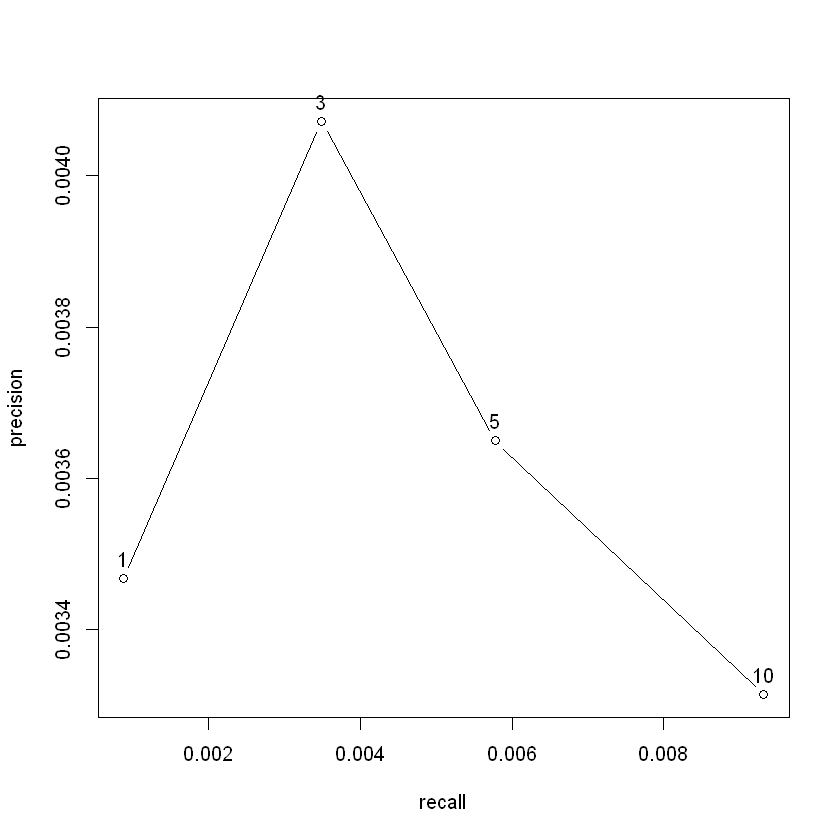

In [79]:
plot(evlist_e7crossGRmed, "prec/rec", annotate=TRUE)

#### Produce a List of Top 5 Thai Restaurants for the Scaled AFINN Dataset and a Matrix for Thai Restaurants in Las Vegas Using  Z-score and center normalization approaches and Cosine, Jaccard and Pearson methods. 

In this exercise, we choose as r7_test the last five users of the original matrix, which we kept apart from e7 and e7crossGR0. r7_train is equivalent to e7 in the previous section of the console.

In [80]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Zc <- Recommender(r7_train, method = "UBCF", param=list(normalize = "Z-score", method="Cosine"))
recom7Zc <- predict(recommender7Zc, r7_test, n=5)
recom7Zc
as(recom7Zc, "list")
recom37Zc <- bestN(recom7Zc, n = 3)
recom7_rateZc <- predict(recommender7Zc, r7_test, type="ratings")
recom7_rateZc
as(recom7_rateZc, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
character(0)

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

5 x 319 rating matrix of class 'realRatingMatrix' with 1271 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2


##### Observations: 

(1) We note that the precision compared to recall increases sharply to N=3 and then decreases gradually.

#### Produce a List of Top 5 Thai Restaurants and a Matrix for Thai Restaurants in Las Vegas Using Z-score and Center Normalization Approaches and Cosine, Jaccard and Pearson Methods.

In this exercise, we choose as r7_test the last five users of the original matrix, which we kept apart from testing purposes.

### Z-score and Cosine Similarity

In [81]:
rec_e7Zc <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "Z-score", method="Cosine"))
pred_rec_e7Zc <- predict(rec_e7Zc, getData(e7, "known"), type="ratings")
err_rec_e7Zc <- calcPredictionAccuracy(pred_rec_e7Zc, getData(e7, "unknown"))
err_rec_e7Zc

RMSE      MSE      MAE 
2.342491 5.487264 1.492923

### Z-score and Jaccard

In [82]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Zj <- Recommender(r7_train, method = "UBCF", param=list(normalize = "Z-score", method="Jaccard"))
recom7Zj <- predict(recommender7Zj, r7_test, n=5)
recom7Zj
as(recom7Zj, "list")
recom37Zj <- bestN(recom7Zj, n = 3)
recom7_rateZj <- predict(recommender7Zj, r7_test, type="ratings")
recom7_rateZj
as(recom7_rateZj, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

5 x 319 rating matrix of class 'realRatingMatrix' with 1589 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2


In [83]:
rec_e7Zj <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "Z-score", method="Jaccard"))
pred_rec_e7Zj <- predict(rec_e7Zj, getData(e7, "known"), type="ratings")
err_rec_e7Zj <- calcPredictionAccuracy(pred_rec_e7Zj, getData(e7, "unknown"))
err_rec_e7Zj

RMSE      MSE      MAE 
2.146852 4.608975 1.839377

### Z-score and Pearson

In [84]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Zp <- Recommender(r7_train, method = "UBCF", param=list(normalize = "Z-score", method="pearson"))
recom7Zp <- predict(recommender7Zp, r7_test, n=5)
recom7Zp
as(recom7Zp, "list")
recom37Zp <- bestN(recom7Zp, n = 3)
recom7_rateZp <- predict(recommender7Zp, r7_test, type="ratings")
recom7_rateZp
as(recom7_rateZp, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
character(0)

[[2]]
character(0)

[[3]]
character(0)

[[4]]
character(0)

[[5]]
character(0)

5 x 319 rating matrix of class 'realRatingMatrix' with 0 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [85]:
rec_e7Zp <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "Z-score", method="pearson"))
pred_rec_e7Zp <- predict(rec_e7Zp, getData(e7, "known"), type="ratings")
err_rec_e7Zp <- calcPredictionAccuracy(pred_rec_e7Zp, getData(e7, "unknown"))
err_rec_e7Zp

RMSE  MSE  MAE 
 NaN  NaN  NaN

### Center and Cosine Similarity

In [86]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Cc <- Recommender(r7_train, method = "UBCF", param=list(normalize = "center", method="Cosine"))
recom7Cc <- predict(recommender7Cc, r7_test, n=5)
recom7Cc
as(recom7Cc, "list")
recom37Cc <- bestN(recom7Cc, n = 3)
recom7_rateCc <- predict(recommender7Cc, r7_test, type="ratings")
recom7_rateCc
as(recom7_rateCc, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
character(0)

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

5 x 319 rating matrix of class 'realRatingMatrix' with 1271 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2


In [87]:
rec_e7Cc <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "center", method="Cosine"))
pred_rec_e7Cc <- predict(rec_e7Cc, getData(e7, "known"), type="ratings")
err_rec_e7Cc <- calcPredictionAccuracy(pred_rec_e7Cc, getData(e7, "unknown"))
err_rec_e7Cc

RMSE      MSE      MAE 
2.345684 5.502233 1.499577

### Center and Jaccard

In [88]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Cj <- Recommender(r7_train, method = "UBCF", param=list(normalize = "center", method="Jaccard"))
recom7Cj <- predict(recommender7Cj, r7_test, n=5)
recom7Cj

paste("The top 5 Thai restaurants for each user of the sample are:")
as(recom7Cj, "list")

recom37Cj <- bestN(recom7Cj, n = 3)
paste("The top 3 Thai restaurants for each user of the sample are:")
as(recom37Cj, "list")

recom7_rateCj <- predict(recommender7Cj, r7_test, type="ratings")
recom7_rateCj
as(recom7_rateCj, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[1] "The top 5 Thai restaurants for each user of the sample are:"

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[2]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"
[4] "_BL-KfyZqYruqDvxTY-vUg" "_IE5XDjxeM47NSzhg7sItg"

[1] "The top 3 Thai restaurants for each user of the sample are:"

[[1]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"

[[2]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"

[[3]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"

[[4]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"

[[5]]
[1] "-hWBlyI2k95yjU-cgwCKJg" "-SNpLwJNup8N96yq7sBJyw" "_0LwsuDU1lG2lwFBrCgzCA"

5 x 319 rating matrix of class 'realRatingMatrix' with 1589 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2
2,2,2,2,2,2,2,2,2,2,<8b>,2,2,2,2,2,2,2,2,2,2


In [89]:
rec_e7Cj <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "center", method="Jaccard"))
pred_rec_e7Cj <- predict(rec_e7Cj, getData(e7, "known"), type="ratings")
err_rec_e7Cj <- calcPredictionAccuracy(pred_rec_e7Cj, getData(e7, "unknown"))
err_rec_e7Cj

RMSE      MSE      MAE 
2.159720 4.664392 1.842703

### Center and Pearson

In [90]:
r7_train <- r7[1:(nrow(r7)-5),]
r7_test <- r7[(nrow(r7)-4):nrow(r7),]
recommender7Cp <- Recommender(r7_train, method = "UBCF", param=list(normalize = "center", method="pearson"))
recom7Cp <- predict(recommender7Cp, r7_test, n=5)
recom7Cp
as(recom7Cp, "list")
recom37Cp <- bestN(recom7Cp, n = 3)
recom7_rateCp <- predict(recommender7Cp, r7_test, type="ratings")
recom7_rateCp
as(recom7_rateCp, "matrix")[,LASthaiRestaurants]

Recommendations as 'topNList' with n = 5 for 5 users. 

[[1]]
character(0)

[[2]]
character(0)

[[3]]
character(0)

[[4]]
character(0)

[[5]]
character(0)

5 x 319 rating matrix of class 'realRatingMatrix' with 0 ratings.

V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [91]:
rec_e7Cp <- Recommender(getData(e7, "train"), method = "UBCF", param=list(normalize = "center", method="pearson"))
pred_rec_e7Cp <- predict(rec_e7Cp, getData(e7, "known"), type="ratings")
err_rec_e7Cp <- calcPredictionAccuracy(pred_rec_e7Cp, getData(e7, "unknown"))
err_rec_e7Cp

RMSE  MSE  MAE 
 NaN  NaN  NaN

### Comparison of 7 Approaches

In [92]:
a <- as.data.frame(err_rec_e7)
b <- as.data.frame(err_rec_e7Zc)
c <- as.data.frame(err_rec_e7Cc)
d <- as.data.frame(err_rec_e7Zj)
e <- as.data.frame(err_rec_e7Cj)
f <- as.data.frame(err_rec_e7Zp)
g <- as.data.frame(err_rec_e7Cp)
h <- c(b,c,d,e,f,g)

error_df <- cbind(a, h)
error_df

,err_rec_e7,err_rec_e7Zc,err_rec_e7Cc,err_rec_e7Zj,err_rec_e7Cj,err_rec_e7Zp,err_rec_e7Cp
RMSE,2.345684,2.342491,2.345684,2.146852,2.15972,NaN,NaN
MSE,5.502233,5.487264,5.502233,4.608975,4.664392,NaN,NaN
MAE,1.499577,1.492923,1.499577,1.839377,1.842703,NaN,NaN


##### Observations:

(1) The recommender models using the Pearson method (err_rec_e7Zp, err_rec_e7Cp) delivers NaN.

(2) err_rec_e7Zj delivers the lowest error.

(3) None of the recommendations produced are meaningful.

(4) All the predictions produced are 2 or NaN: this scaled AFINN-based approach is NOT adequate.

### SAMPLING COMPUTATIONS FOR LAS VEGAS RESTAURANTS GREATER THAN ZERO REVIEWS BELOW

The purpose of this section is to put into practice models for recommending top 5 Thai restaurants in Las Vegas with the best results and accuracy combined. As a sample, we select the test set from e5 (getData(e5,"known")) used for predictions earlier in this console and narrow it down to users with one or more predicted ratings in Las Vegas. PLEASE NOTE THAT WE INADVERTENTLY CALLED THE TEST SET BY THE NAME: TRAINING_KNOWN. We use only five random users from this sample to produce the top 5 Thai restaurants in Las Vegas for each user. Needless to say that the model produces no meaningful recommendations to some users. A re-run of the commands from the sampling command onward maybe necessary if you are using this console to review its capabilities or for another project. The following commands are extensive. Not all of them are necessary to accomplish the task. The objective behind the extra lines is to get a clearer picture of what some of the recommenderlab functions do exactly.

In [93]:
r7LAS <- r7[,LASthaiRestaurants]

In [94]:
r7LAS

7741 x 106 rating matrix of class 'realRatingMatrix' with 1191 ratings.

In [95]:
training_known <- getData(e7, "known")
e7LAS <- training_known[,LASthaiRestaurants]
e7LAS

779 x 106 rating matrix of class 'realRatingMatrix' with 46 ratings.

In [96]:
as(r7LAS, "matrix")

,V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
--65q1FpAL_UQtVZ2PTGew,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
--ijvARuRJhZrBdS9_jF2A,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
--ohLoec6PU9_yxhbIlVWg,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
--qEXbk-cA0HmbPyhcffdA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-_2B4LLGfWvxReflguaYrw,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-_GtJEB9B4Ckm7Cd8RIq1A,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-0fMBkX7QvWKQrtOp7H-GQ,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-2EuoueswhqEERWezJY8gw,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-2Ig3GSBkj8JQT8eETmDPg,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-3WzrbWjnaKg2QWAsouy_g,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


In [97]:
as(e7LAS, "matrix")

,V6csWcyvwOg_E2ni3V_CgA,H2eCY4wIIudy5C0BW5Y3ZQ,TLGCA3EQW_12ndci12dQWw,dR-Zz3l3ws-P08dI6F8Zew,DqzyOJTJXu0Iwi8og5DJDA,KwLfgeylp9d8zY3KacREiw,QXTN5WwZxvf-Z940RmDUdQ,X0cEpOYi0Gf-S_-xb8OZVQ,7P9k2NQPeIyF1TkH5cKQVg,ZZtEx_UutNxz9B5knTL4tQ,,s4Ki8L-zutVJexVSnFlP-Q,Q3a7xKU_KrOT8Mli5X6aWg,q5WYH27RJoNt_yFLNXIThw,fUQz6bofFVS3pKPJOBQQ5A,6bBJymP2jh-tenBY8zvL1A,H0UWIZCL3f_blpL7rQdgPg,kiA-L7r9uHh2bqUPxuCzNQ,nuHftEWNyMIsa4R4OpqlQg,D54vs93Q3NZkh5P99V2n6A,3uUYfeMGAywRy1aN01n-Sg
--ijvARuRJhZrBdS9_jF2A,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-9g6w1xoj6-4iZH29P3h7g,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-dzrDpNe5f0hDud-S-W26w,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-F32Vl8Rk4dwsmk0f2wRIw,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-GPQbucelen3W0yCtSdcFQ,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-jArZigWp_awu-Q3EYRDUg,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-kCWyWuA2AfF63RRqfxTlA,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-lSUv9egzYVoJpl1F_WHYw,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-M3IPEX5B-qwvETd6rkKNQ,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA
-N2PwxuFkcu7HF_fVnBHEQ,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA,<8b>,NA,NA,NA,NA,NA,NA,NA,NA,NA,NA


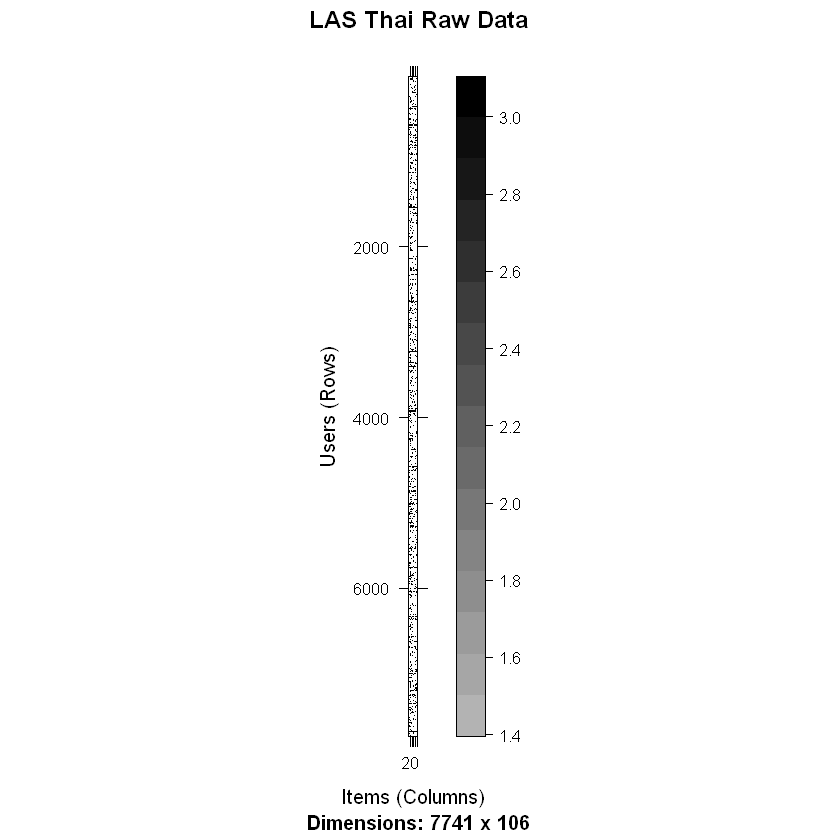

In [98]:
image(r7LAS, main="LAS Thai Raw Data")

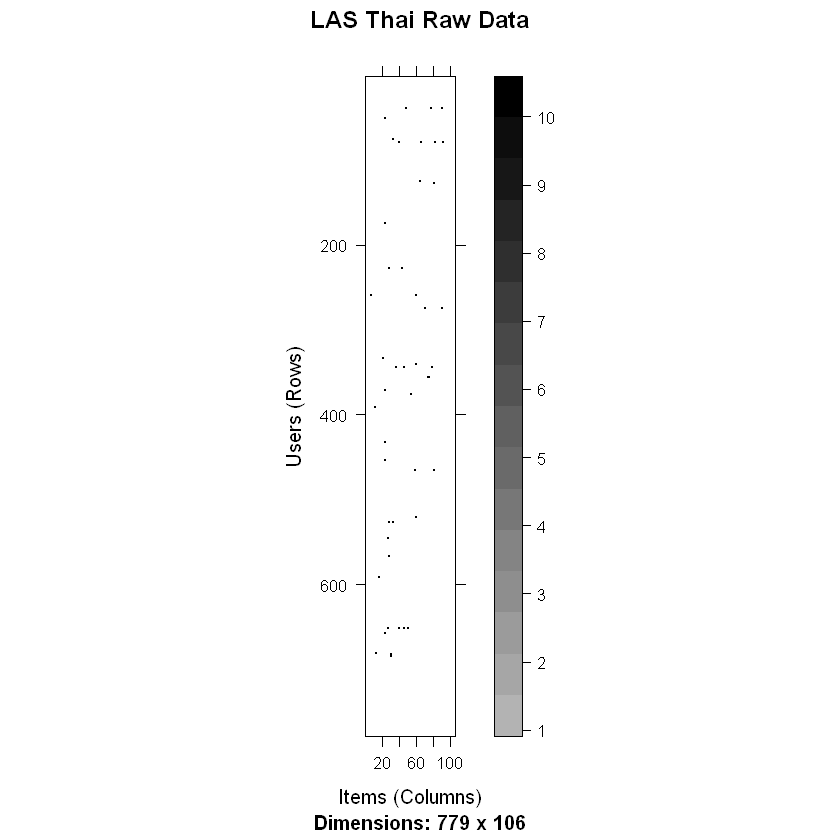

In [99]:
image(e7LAS, main="LAS Thai Raw Data")

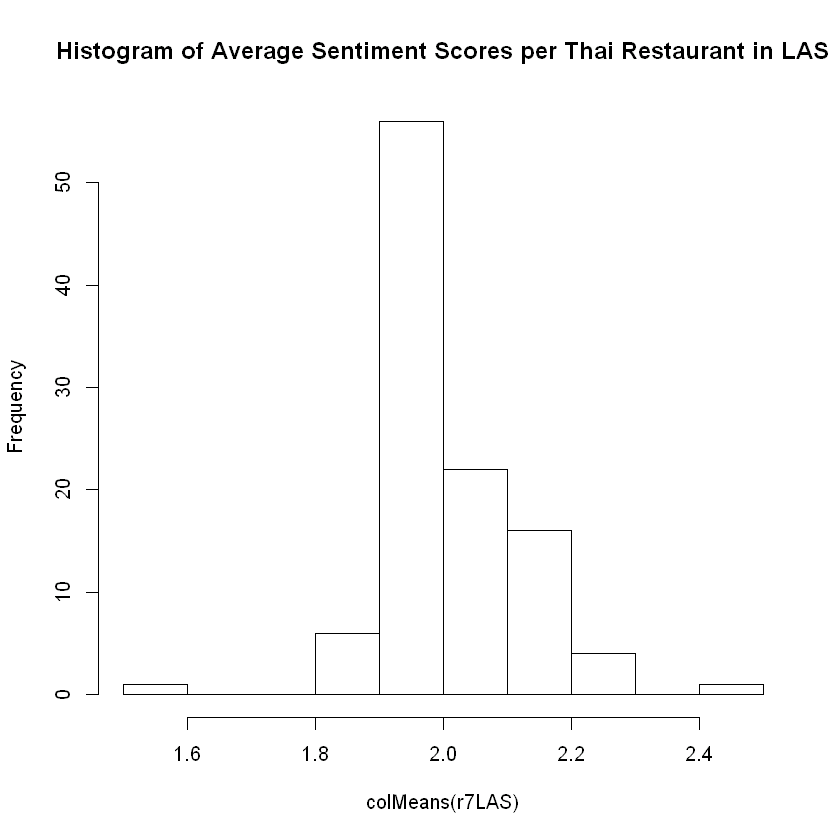

In [100]:
hist(colMeans(r7LAS), main="Histogram of Average Sentiment Scores per Thai Restaurant in LAS")

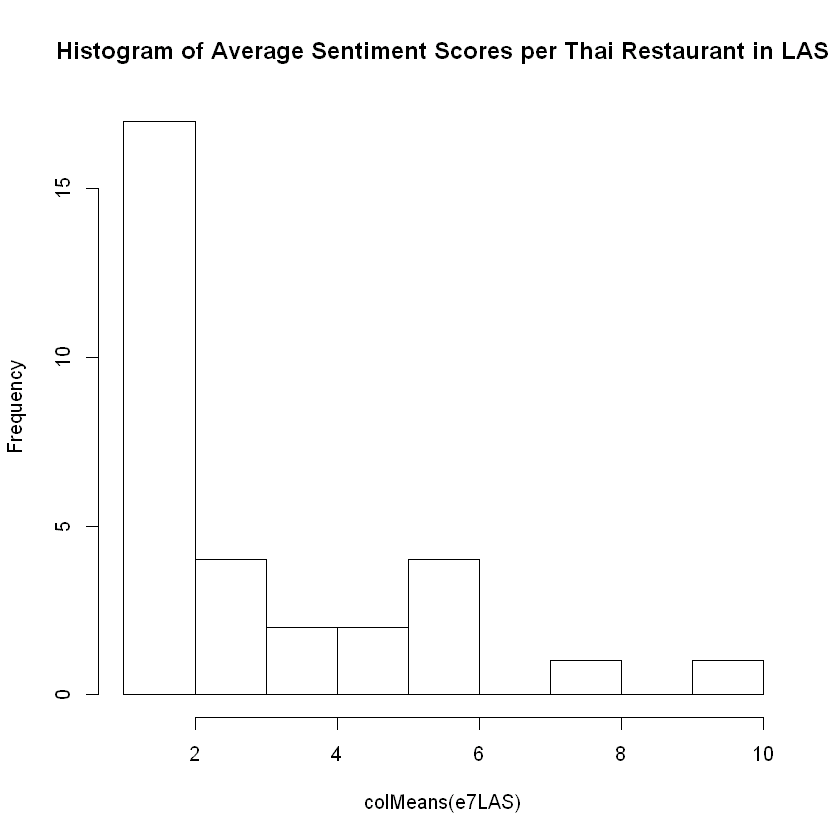

In [101]:
hist(colMeans(e7LAS), main="Histogram of Average Sentiment Scores per Thai Restaurant in LAS")

In [102]:
r7LASWithNOfullZeros <- r7LAS[which(rowSums(r7LAS) != 0), ]

In [103]:
e7LASWithNOfullZeros <- e7LAS[which(rowSums(e7LAS) != 0), ]

[1] 7741

[1] 713

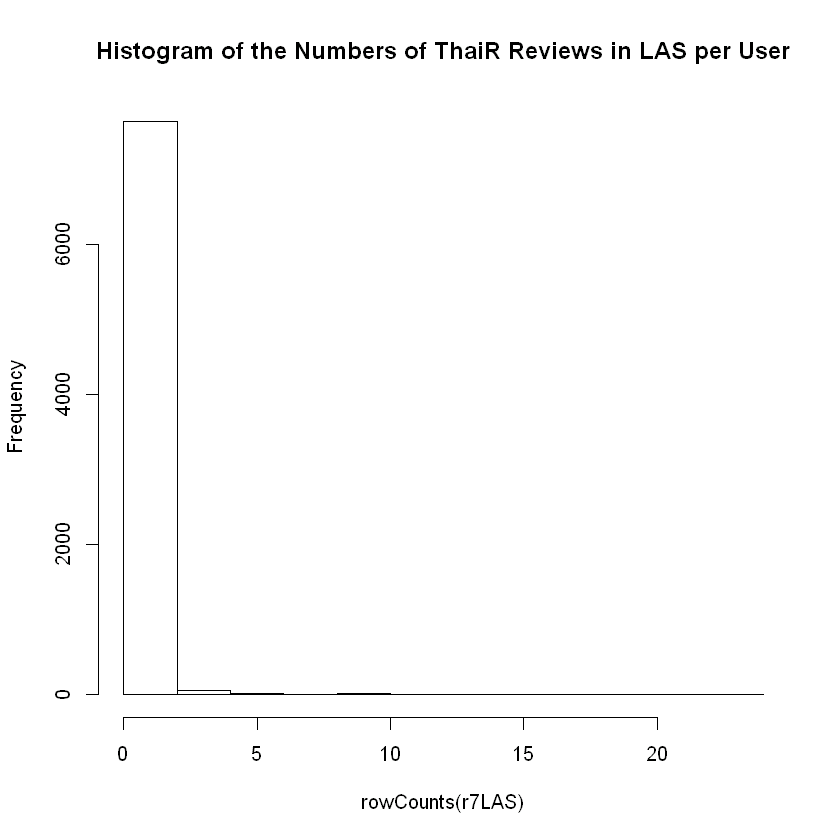

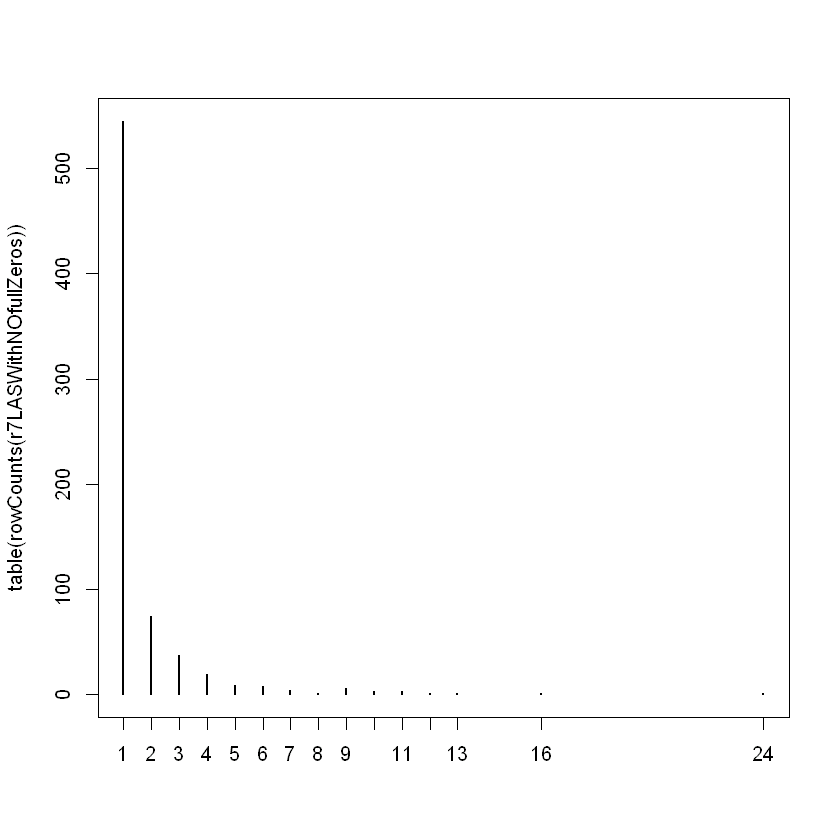

In [104]:
length(rowCounts(r7LAS))
length(rowCounts(r7LASWithNOfullZeros))      
hist(rowCounts(r7LAS), main="Histogram of the Numbers of ThaiR Reviews in LAS per User")
plot(table(rowCounts(r7LASWithNOfullZeros)))

In [105]:
table(rowCounts(r7LAS))


   0    1    2    3    4    5    6    7    8    9   10   11   12   13   16   24 
7028  545   74   37   19    9    8    4    1    6    3    3    1    1    1    1 

In [106]:
table(rowCounts(e7LAS))


  0   1   2   3   4 
749  20   6   2   2 

In [107]:
table(rowCounts(r7))


   1    2    3    4    5    6    7    8    9   10   11   12   13   14   16   17 
6163  934  333  129   61   35   26   16   13   10    6    1    2    2    3    1 
  18   19   21   23   24 
   1    1    2    1    1 

In [108]:
table(rowCounts(r7[1:(nrow(r7)-5),]))


   1    2    3    4    5    6    7    8    9   10   11   12   13   14   16   17 
6159  933  333  129   61   35   26   16   13   10    6    1    2    2    3    1 
  18   19   21   23   24 
   1    1    2    1    1 

##### Observations:

(1) We observe that e7LAS has 749 rows with NAs across all the columns.

(2) We observe that r7 has no rows with NAs across all columns, but we also observe that 6159 rows have only 1 score. This large sample of users pose as the cold-start problem in a recommender model based on similarity patterns between users.

In [109]:
table(rowCounts(r7LASWithNOfullZeros))


  1   2   3   4   5   6   7   8   9  10  11  12  13  16  24 
545  74  37  19   9   8   4   1   6   3   3   1   1   1   1 

In [110]:
table(rowCounts(e7LASWithNOfullZeros))


 1  2  3  4 
20  6  2  2 

In [111]:
r7LASnoFzList <-rownames(r7LASWithNOfullZeros)

In [112]:
e7LASnoFzList <-rownames(e7LASWithNOfullZeros)

In [113]:
length(r7LASnoFzList)

[1] 713

In [114]:
length(e7LASnoFzList)

[1] 30

##### Observations:

(1) The sample from which we draw users for recommending top 5 restaurants in Las Vegas has 30 users, of which 20 have one predicted rating, 6 have two predicted ratings, 2 have three predicted ratings and 2 have four predicted ratings. We acknowledge that the similarity patterns in Las Vegas between users are few in this sample. 

In [115]:
sample_reviewers_oneplus_e7 <- sample(e7LASnoFzList, 5)

In [116]:
sample_reviewers_oneplus_e7

[1] "DZA42SwMcDfTiDi_ePSYLg" "Q3PTm7I9xAru4kd2mljM0Q" "0XRFyY8-dxmrDheFPpe8Sg"
[4] "WR9pKtQEhI4lSCnBNtDRqQ" "Ii3Fn61iHBdT-cvoTtYkow"

#### Using the Model with the Second Lowest Error, Identify Top 5 Recommendations for sample_reviewers_oneplus_e7 (Jaccard method)

We acknowledge that this subsection should have been dedicated to the model with the lowest error (Zj); however, when we noticed the discrepancy, the kernel was no longer operating. Nevertheless, the Jaccard method below with the Centre approach still delivers recommendations for Las Vegas although it's not clear with the data whether these recommendations had meaning or not as we did not call the predictions from the matrix. Nevertheless, our observations above show that the approach using the scaled AFINN sentiment scores is NOT RELIABLE.  

In [119]:
reviewers_recommendations_7Cj <- predict(rec_e7Cj, training_known[sample_reviewers_oneplus_e7,],type="ratings")
LASreviewers_recommendation_Mx_7Cj <- as(reviewers_recommendations_7Cj[,LASthaiRestaurants], "matrix")
t(apply(LASreviewers_recommendation_Mx_7Cj, 1, FUN= function(x) order(-x)[1:5]))

23,27,6,63,39
1,2,3,4,5
23,39,35,25,7
1,2,3,4,5
1,2,3,4,5


In [120]:
colnumlist7Cj <- as.list(as.data.frame(apply(LASreviewers_recommendation_Mx_7Cj, 1, FUN= function(x) order(-x)[1:5])))
colnumlist7Cj

$V1
[1] 23 27  6 63 39

$V2
[1] 1 2 3 4 5

$V3
[1] 23 39 35 25  7

$V4
[1] 1 2 3 4 5

$V5
[1] 1 2 3 4 5

In [121]:
top5FORuser1_7Cj <- colnames(LASreviewers_recommendation_Mx_7Cj[,colnumlist7Cj$V4])
top5FORuser1_7Cj
top5FORuser1_7Cj_df <- as.data.frame(top5FORuser1_7Cj)
colnames(top5FORuser1_7Cj_df) <-"business_id"
top5FORuser1_7Cj_df2 <- merge(x= top5FORuser1_7Cj_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)
top5FORuser1_7Cj_df2

[1] "V6csWcyvwOg_E2ni3V_CgA" "H2eCY4wIIudy5C0BW5Y3ZQ" "TLGCA3EQW_12ndci12dQWw"
[4] "dR-Zz3l3ws-P08dI6F8Zew" "DqzyOJTJXu0Iwi8og5DJDA"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,V6csWcyvwOg_E2ni3V_CgA,Little Dumpling,"180 S Stephanie St Henderson, NV 89012",[],Henderson,NV,36.02288,-115.0466,1,3,False
2,H2eCY4wIIudy5C0BW5Y3ZQ,Bangkok Orchid,"4662 E Sunset Rd Henderson, NV 89014",[],Henderson,NV,36.07098,-115.0722,1,3.5,True
3,TLGCA3EQW_12ndci12dQWw,Bangkok 9 Thai-Chinese Food,"663 N Stephanie St Henderson, NV 89014",[],Henderson,NV,36.06579,-115.0463,2,3.5,True
4,dR-Zz3l3ws-P08dI6F8Zew,Royal Thai Restaurant,"3839 W Sahara Ave Ste 9 Westside Las Vegas, NV 89102",[Westside],Las Vegas,NV,36.14401,-115.1931,2,4.5,True
5,DqzyOJTJXu0Iwi8og5DJDA,Ocha Cuisine,"1201 Las Vegas Blvd S Downtown Las Vegas, NV 89104",[Downtown],Las Vegas,NV,36.15677,-115.1483,1,4,True


Map from URL : http://maps.googleapis.com/maps/api/staticmap?center=Las+Vegas&zoom=10&size=640x640&scale=2&maptype=roadmap&language=en-EN&sensor=false
Information from URL : http://maps.googleapis.com/maps/api/geocode/json?address=Las%20Vegas&sensor=false


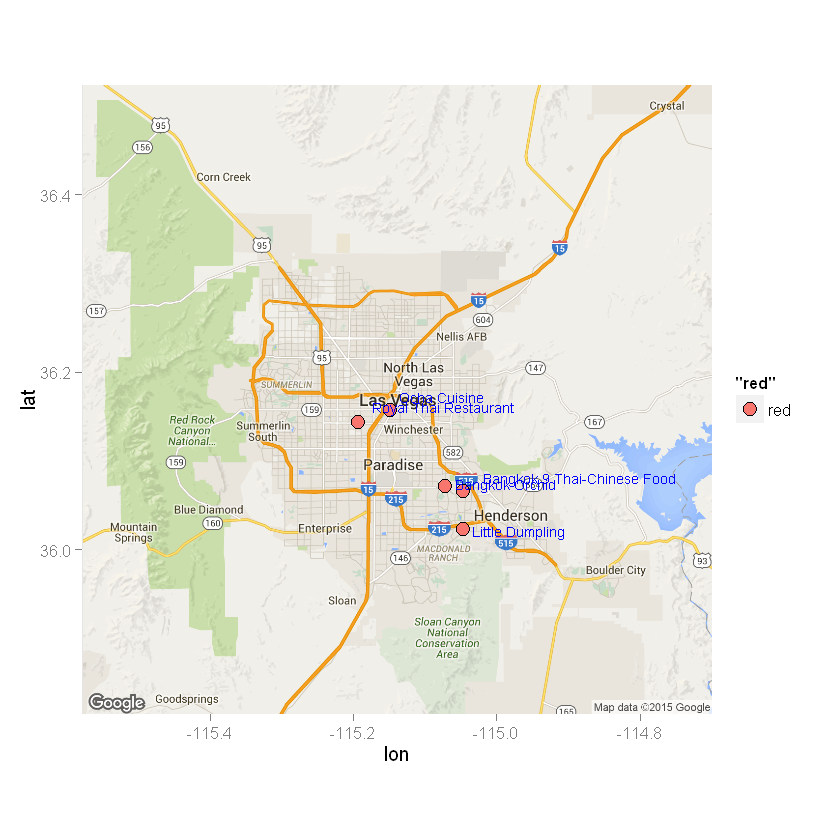

In [122]:
lon <- top5FORuser1_7Cj_df2$longitude
lat <- top5FORuser1_7Cj_df2$latitude
label <- paste(top5FORuser1_7Cj_df2$name)
df <- data.frame(lon,lat,label)
map <- get_map(location="Las Vegas", source="google", maptype="roadmap", zoom=10)
ggmap(map) + geom_point(data = df, 
                      aes(x = lon, y = lat,
                      fill = "red", label = label),
                      size = 4, shape = 21) +
            geom_text(data = df, position=position_jitter(width=-0.01,height=0.00991),
                     aes(x = lon, y = lat, label = label),
                     color = 'blue', size = 3, vjust = -0.1, hjust = -0.1)


In [123]:
df

,lon,lat,label
1,-115.0466,36.02288,Little Dumpling
2,-115.0722,36.07098,Bangkok Orchid
3,-115.0463,36.06579,Bangkok 9 Thai-Chinese Food
4,-115.1931,36.14401,Royal Thai Restaurant
5,-115.1483,36.15677,Ocha Cuisine


In [124]:
top5FORuser2_7Cj <- colnames(LASreviewers_recommendation_Mx_7Cj[,colnumlist7Cj$V2])
top5FORuser2_7Cj
top5FORuser2_7Cj_df <- as.data.frame(top5FORuser2_7Cj)
colnames(top5FORuser2_7Cj_df) <-"business_id"
merge(x= top5FORuser2_7Cj_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

[1] "V6csWcyvwOg_E2ni3V_CgA" "H2eCY4wIIudy5C0BW5Y3ZQ" "TLGCA3EQW_12ndci12dQWw"
[4] "dR-Zz3l3ws-P08dI6F8Zew" "DqzyOJTJXu0Iwi8og5DJDA"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,V6csWcyvwOg_E2ni3V_CgA,Little Dumpling,"180 S Stephanie St Henderson, NV 89012",[],Henderson,NV,36.02288,-115.0466,1,3,False
2,H2eCY4wIIudy5C0BW5Y3ZQ,Bangkok Orchid,"4662 E Sunset Rd Henderson, NV 89014",[],Henderson,NV,36.07098,-115.0722,1,3.5,True
3,TLGCA3EQW_12ndci12dQWw,Bangkok 9 Thai-Chinese Food,"663 N Stephanie St Henderson, NV 89014",[],Henderson,NV,36.06579,-115.0463,2,3.5,True
4,dR-Zz3l3ws-P08dI6F8Zew,Royal Thai Restaurant,"3839 W Sahara Ave Ste 9 Westside Las Vegas, NV 89102",[Westside],Las Vegas,NV,36.14401,-115.1931,2,4.5,True
5,DqzyOJTJXu0Iwi8og5DJDA,Ocha Cuisine,"1201 Las Vegas Blvd S Downtown Las Vegas, NV 89104",[Downtown],Las Vegas,NV,36.15677,-115.1483,1,4,True


In [125]:
top5FORuser3_7Cj <- colnames(LASreviewers_recommendation_Mx_7Cj[,colnumlist7Cj$V3])
top5FORuser3_7Cj
top5FORuser3_7Cj_df <- as.data.frame(top5FORuser3_7Cj)
colnames(top5FORuser3_7Cj_df) <-"business_id"
merge(x= top5FORuser3_7Cj_df, y= ThaiRestaurants, by = "business_id", all.x = TRUE, sort=FALSE)

[1] "lliksv-tglfUz1T3B3vgvA" "CLp44IJDJW2mBhSjdBIMiQ" "l3L25Yg_8E11tsS2D8ml-g"
[4] "qXFAEWRjEgXO3RXOzMAjBg" "QXTN5WwZxvf-Z940RmDUdQ"

,business_id,name,full_address,neighborhoods,city,state,latitude,longitude,price_range,avg_stars,WaiterService
1,lliksv-tglfUz1T3B3vgvA,Lotus of Siam,"953 E Sahara Ave Ste A-5 Eastside Las Vegas, NV 89104","[Eastside, Downtown]",Las Vegas,NV,36.14357,-115.1428,2,4,True
2,CLp44IJDJW2mBhSjdBIMiQ,Penn's Thai House,"724 W Sunset Rd Henderson, NV 89011",[],Henderson,NV,36.06391,-115.0235,2,4,True
3,l3L25Yg_8E11tsS2D8ml-g,Thai Food To Go,"3242 E Desert Inn Rd Ste 9 Eastside Las Vegas, NV 89121",[Eastside],Las Vegas,NV,36.13023,-115.1038,1,4.5,True
4,qXFAEWRjEgXO3RXOzMAjBg,Thai Vegas,"115 N 4th St Downtown Las Vegas, NV 89101",[Downtown],Las Vegas,NV,36.17034,-115.1416,1,3.5,True
5,QXTN5WwZxvf-Z940RmDUdQ,Thai Grill,"1901 N Decatur Blvd Las Vegas, NV 89108",[],Las Vegas,NV,36.19415,-115.2061,2,3.5,True


##### Observations:

(1) Although this model using the scaled AFINN sentiment scores is UNRELIABLE for recommendations, we have realized from this exercise that it is a good idea to check the predictions from the model before committing to making a recommendation of the top 5 restaurants to a user. This would improve not only the project's consistency, but also the recommendations provided. It's a matter of quality assurance.

In [126]:
save.image(file = "recommender with review scores computed with AFINN Lex SCALED.RData", version = NULL)